In [2]:
!pip install wandb

In [3]:
import os
import random
import numpy as np
from pathlib import Path
import pandas as pd
import torch
import torchvision
from torch.utils.data import Dataset, DataLoader
import torchvision.transforms as transforms
from PIL import Image
import matplotlib.pyplot as plt
from tqdm import tqdm
from torchvision.utils import make_grid
# import albumentations as A
# from albumentations.pytorch import ToTensorV2
import wandb
import torchmetrics
from torchvision.models import inception_v3
from scipy.stats import entropy
import torch.nn as nn
import torch.nn.functional as F
import torchvision.models as models
from scipy.linalg import sqrtm

In [4]:
TRAIN_SKETCH_PATH_PAIRED = "/kaggle/input/gan-dataset/Assignment_4/Train/Paired_train_sketches/Paired_train_sketches"
TRAIN_DATA_PATH = "/kaggle/input/gan-dataset/Assignment_4/Train/Train_data/Train_data"
TRAIN_DATA_CSV_PATH = "/kaggle/input/gan-dataset/Assignment_4/Train/Train_labels.csv"

In [5]:
TEST_SKETCH_PATH_PAIRED = "/kaggle/input/gan-dataset/Assignment_4/Test/Paired_test_sketch/Paired_test_sketch"
TEST_DATA_PATH = "/kaggle/input/gan-dataset/Assignment_4/Test/Test_data/Test_data"
TEST_DATA_CSV_PATH = "/kaggle/input/gan-dataset/Assignment_4/Test/Test_labels.csv"

In [6]:
IMG_WIDTH = 128
IMG_HEIGHT = 128
SKETCH_WIDTH = 128
SKETCH_HEIGHT = 128
BATCH_SIZE = 32
NUM_WORKERS = 2
DEVICE = "cuda:0" if torch.cuda.is_available() else "cpu"

In [7]:
DEVICE

'cuda:0'

In [8]:
def find_class(one_hot_vec):
    for i, x in enumerate(one_hot_vec):
        if x == 1:
            return i

In [9]:
class CustomDataset(Dataset):
  def __init__(self, img_path, sketch_path, csv_data_frame_path, transform_img=None, transform_sketch=None):
    self.img_dir = img_path
    self.sketch_dir = sketch_path
    self.data_frame = pd.read_csv(csv_data_frame_path)
    self.transform_img = transform_img
    self.transform_sketch = transform_sketch
    self.sketch_images = os.listdir(sketch_path)

  def __len__(self):
    return len(self.data_frame)

  def __getitem__(self, idx):
    img_name = os.path.join(self.img_dir, self.data_frame.iloc[idx, 0])
    img = Image.open(img_name + '.jpg').convert('RGB')
    label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
    img_class = find_class(label)
    
    sketch_file_name = os.path.join(self.sketch_dir, self.data_frame.iloc[idx, 0] + '_segmentation.png')
    sketch_img = Image.open(sketch_file_name).convert('RGB')

#     random_index = random.randint(0, len(self.sketch_images) - 1)
#     sketch_name = self.sketch_images[random_index]
#     sketch_img = Image.open(self.sketch_dir + '/' + sketch_name).convert('RGB')

    if self.transform_img:
#         img = np.array(img)
#         sketch_img = np.array(sketch_img)
#         augmented = self.transform_img(image=img, s_img=sketch_img)
#         img = augmented['image']
#         sketch_img = augmented['s_img']
        img = self.transform_img(img)

    if self.transform_sketch:
      sketch_img = self.transform_sketch(sketch_img)

    return img, label, sketch_img, img_class

In [10]:
class CustomDataLoader:
  def __init__(self):
    pass

  def setup(self):
    transform_img = transforms.Compose([
        transforms.Resize((IMG_WIDTH, IMG_HEIGHT)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
    ])
#     transform_img = A.Compose([
#         A.Resize(IMG_WIDTH, IMG_HEIGHT),
# #         A.ShiftScaleRotate(shift_limit=0.2, scale_limit=0.2, rotate_limit=30, p=0.5),
# #         A.RGBShift(r_shift_limit=25, g_shift_limit=25, b_shift_limit=25, p=0.5),
# #         A.RandomBrightnessContrast(brightness_limit=0.3, contrast_limit=0.3, p=0.5),
# #         A.ColorJitter(brightness=0.1, contrast=0.1, saturation=0.1, hue=0.1),
#         A.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5], max_pixel_value=255.0,),
#         ToTensorV2(),
#     ])

    transform_sketch = transforms.Compose([
        transforms.Resize((SKETCH_WIDTH, SKETCH_HEIGHT)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
    ])

    self.train_dataset = CustomDataset(TRAIN_DATA_PATH, TRAIN_SKETCH_PATH_PAIRED, TRAIN_DATA_CSV_PATH, transform_img, transform_sketch)
    self.test_dataset = CustomDataset(TEST_DATA_PATH, TEST_SKETCH_PATH_PAIRED, TEST_DATA_CSV_PATH, transform_img, transform_sketch)

  def train_dataloader(self):
    return DataLoader(self.train_dataset, batch_size=BATCH_SIZE, shuffle=True, num_workers=NUM_WORKERS)

  def test_dataloader(self):
    return DataLoader(self.test_dataset, batch_size=BATCH_SIZE, shuffle=False, num_workers=NUM_WORKERS)

In [11]:
data_loader = CustomDataLoader()
data_loader.setup()

In [15]:
images, labels, sketches, classes = next(iter(data_loader.train_dataloader()))

/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)


In [16]:
print(images.shape, labels.shape, sketches.shape, classes.shape)

torch.Size([32, 3, 128, 128]) torch.Size([32, 7]) torch.Size([32, 3, 128, 128]) torch.Size([32])


In [18]:
classes

tensor([1, 1, 4, 1, 1, 1, 1, 1, 2, 1, 2, 4, 1, 4, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
        1, 2, 1, 5, 2, 1, 6, 1])

In [17]:
def display_image(image):
  pil_image = transforms.functional.to_pil_image(image)
  plt.figure(figsize=(8, 8))
  plt.imshow(pil_image)
  plt.title('Sample Image')
  plt.axis('off')
  plt.show()

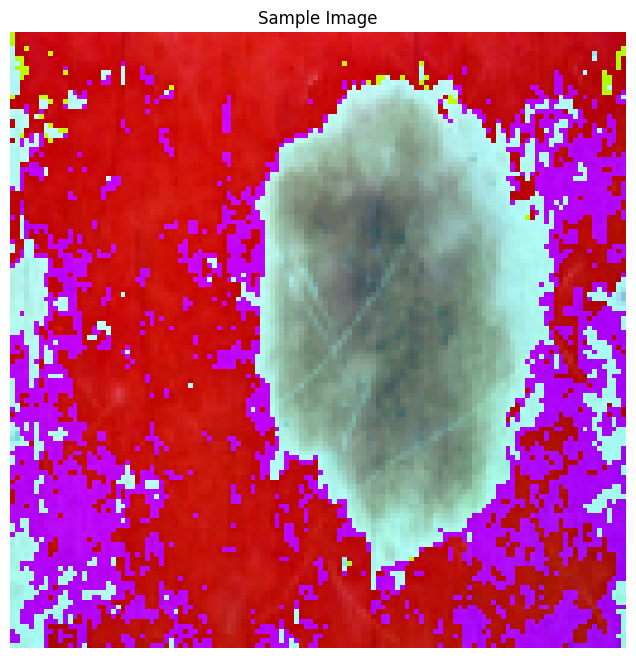

In [16]:
display_image(images[3])

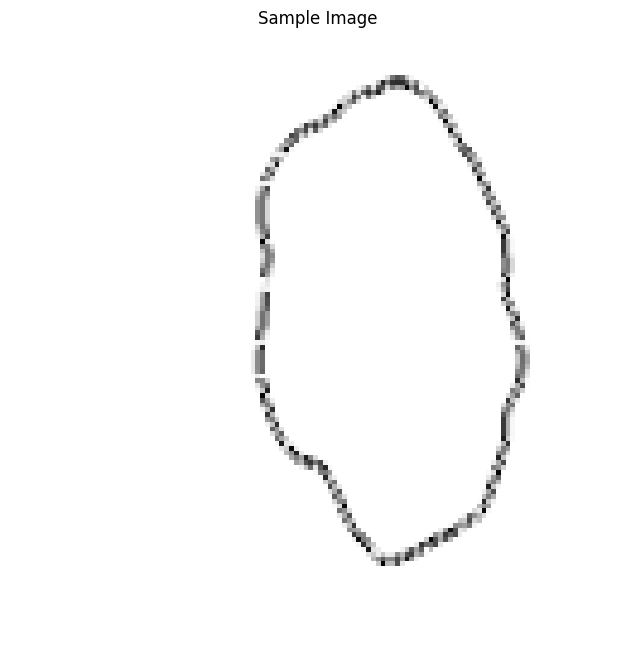

In [17]:
display_image(sketches[3])

In [9]:
data_frame = pd.read_csv(TRAIN_DATA_CSV_PATH)
column_names = data_frame.columns.tolist()[1:]
print(column_names)

['MEL', 'NV', 'BCC', 'AKIEC', 'BKL', 'DF', 'VASC']


In [15]:
grouped_data = {}
for column in column_names:
    # Check if the column contains 1
    if (data_frame[column] == 1).any():
        # Group the DataFrame by the column where the value is 1
#         grouped_data[column] = data_frame[data_frame[column] == 1]
        grouped_data[column] = data_frame.loc[data_frame[column] == 1, 'image'].tolist()


In [ ]:
grouped_data

In [17]:
random_images_by_column = {}
num_images_to_choose = 32
for key, image_names in grouped_data.items():
    random_images = random.sample(image_names, num_images_to_choose)
    random_images_by_column[key] = random_images

In [ ]:
random_images_by_column

In [47]:
def find_class(one_hot_vec):
    for i, x in enumerate(one_hot_vec):
#         print(x)
        if x:
            return i

In [48]:
transform_img = transforms.Compose([
        transforms.Resize((IMG_WIDTH, IMG_HEIGHT)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
    ])

In [50]:
dataloader_dict = {}

In [51]:
for i in column_names:
    data = []
    for j in random_images_by_column[i]:
#         print(j)
        img_path = TRAIN_DATA_PATH + "/" + j + '.jpg'
        img = Image.open(img_path).convert('RGB')
        filtered_df = data_frame[data_frame['image'] == j]
        label = torch.tensor(filtered_df.iloc[:, 1:].values[0], dtype=torch.float32)
        img_class = find_class(np.array(label))
        
        sketch_path = TRAIN_SKETCH_PATH_PAIRED + '/' + j + '_segmentation.png'
        sketch_img = Image.open(sketch_path).convert('RGB')
        img = transform_img(img)
        sketch_img = transform_img(sketch_img)
        data.append((img, label, sketch_img, img_class))
#         print(img_path)
#         print(sketch_path)
#         print(label, label.shape, img_class)
#         break
    data_loader = DataLoader(data, batch_size=BATCH_SIZE, shuffle=False)
    dataloader_dict[i] = data_loader

In [52]:
dataloader_dict

{'MEL': <torch.utils.data.dataloader.DataLoader at 0x7b82434a07f0>,
 'NV': <torch.utils.data.dataloader.DataLoader at 0x7b82434de500>,
 'BCC': <torch.utils.data.dataloader.DataLoader at 0x7b8243590ee0>,
 'AKIEC': <torch.utils.data.dataloader.DataLoader at 0x7b82432e7b80>,
 'BKL': <torch.utils.data.dataloader.DataLoader at 0x7b82432e78e0>,
 'DF': <torch.utils.data.dataloader.DataLoader at 0x7b8240b7bcd0>,
 'VASC': <torch.utils.data.dataloader.DataLoader at 0x7b82432e7af0>}

In [53]:
images, labels, sketches, classes = next(iter(dataloader_dict['MEL']))

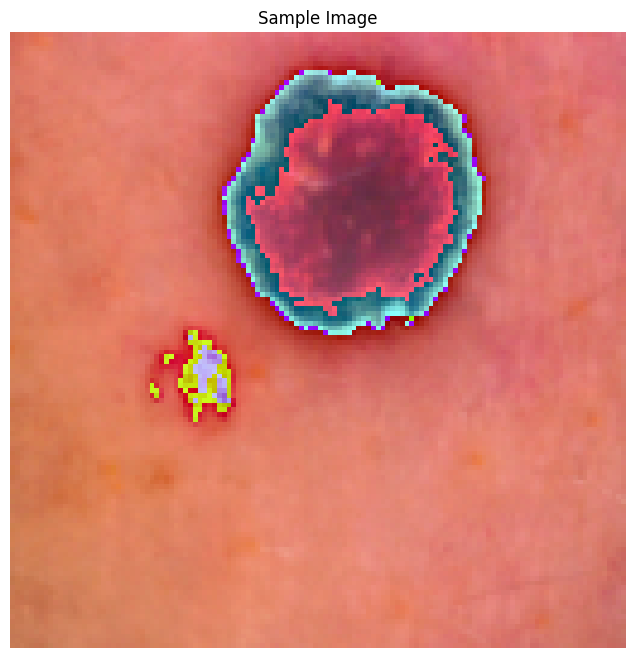

In [68]:
display_image(images[15])

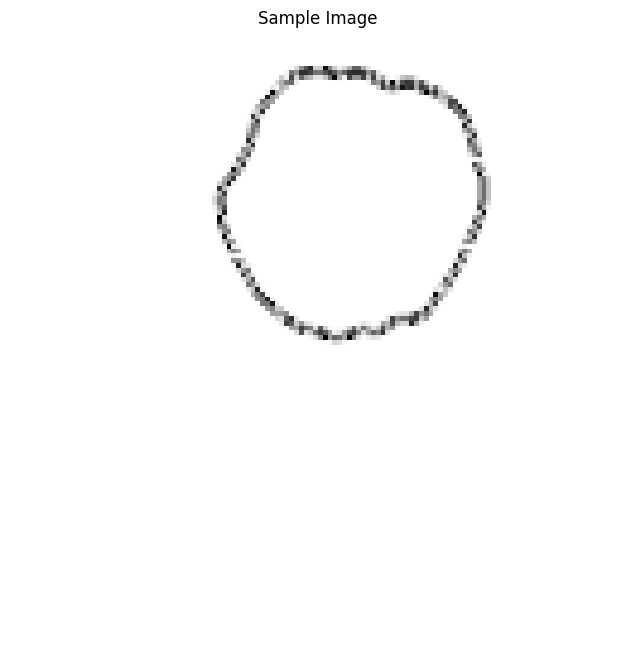

In [69]:
display_image(sketches[15])

In [54]:
print(images.shape, labels.shape, sketches.shape, classes.shape)

torch.Size([32, 3, 128, 128]) torch.Size([32, 7]) torch.Size([32, 3, 128, 128]) torch.Size([32])


In [12]:
# wandb.login()
wandb.init(project='DL_assignment4', name='task5')

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

  ········································


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


In [32]:
wandb.init(project='DL_assignment4', name='task4')

Test_Accuracy,▁█
Trainig_Accuracy,▁█
training_loss_clssifier,▁█
Test_Accuracy,59.0
Trainig_Accuracy,70.03882
training_loss_clssifier,0.88739


In [13]:
import torch.nn as nn
import torch.nn.init as init

class CNN_Classifier(nn.Module):
  def __init__(self, number_of_classes=7, dropout_prob=0.1):
    super(CNN_Classifier, self).__init__()
    self.resnet = torchvision.models.resnet50(weights='ResNet50_Weights.DEFAULT')
#     for param in self.resnet.parameters():
#         param.requires_grad = False
    
    self.resnet.fc = nn.Linear(self.resnet.fc.in_features, number_of_classes)
#     self.hidden_layers = nn.Sequential(
#         nn.Conv2d(3, 16, 4, 2),
#         nn.BatchNorm2d(16),
#         nn.ReLU(),
#         nn.MaxPool2d(2, stride=2, padding=0),
#         # nn.Dropout(p=dropout_prob),
#         nn.Conv2d(16, 32, 4, 2),
#         nn.BatchNorm2d(32),
#         nn.ReLU(),
#         nn.MaxPool2d(2, stride=1, padding=0),
# #         # nn.Dropout(p=dropout_prob),
#         nn.Conv2d(32, 64, 4, 2),
#         nn.BatchNorm2d(64),
#         nn.ReLU(),
#         nn.AvgPool2d(2, stride=2, padding=0)
#     )
#     self.full_layer = nn.Sequential(
#         nn.Linear(256, number_of_classes),
#         # nn.BatchNorm1d(number_of_classes),
#         # nn.Dropout(p=dropout_prob)
#     )

#     for layer in [self.hidden_layers[0], self.hidden_layers[3], self.hidden_layers[6]]:
#       if isinstance(layer, nn.Conv2d):
#         init.kaiming_normal_(layer.weight, nonlinearity='relu')
#     if isinstance(self.full_layer[0], nn.Linear):
#       init.xavier_uniform_(self.full_layer[0].weight)

  def forward(self, x):
#     x = self.hidden_layers(x)
#     x = x.view(x.size(0), -1)
#     x = self.full_layer(x)
    x = self.resnet(x)
    return x

In [38]:
classifier = CNN_Classifier().to(DEVICE)
classifier

CNN_Classifier(
  (resnet): ResNet(
    (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (relu): ReLU(inplace=True)
    (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (layer1): Sequential(
      (0): Bottleneck(
        (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
        (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace=True)
        (downsample): Sequential(
    

In [39]:
img_from_gen = torch.randn(32, 3, 128, 128).to(DEVICE)
classifier(img_from_gen).shape

torch.Size([32, 7])

In [41]:
loss_function = nn.CrossEntropyLoss()
optimizer = torch.optim.Adam(classifier.parameters(), lr=0.0001, betas=(0.5, 0.999))

In [42]:
def evaluation(data_loader):
  classifier.eval()
  total, correct = 0, 0

  with torch.no_grad():
    for data in data_loader:
      inputs, _, _, labels = data
      inputs, labels = inputs.to(DEVICE), labels.to(DEVICE)
      outputs = classifier(inputs)
      _, prediction = torch.max(outputs.data, 1)
      total = total + labels.size(0)
      correct = correct + (prediction == labels).sum().item()
  return correct * 100 / total

In [43]:
# %%time
max_epochs = 10
loss_epoch_arr = []
training_accuracy_per_epoch = []
testing_accuracy_per_epoch = []

for epoch in range(max_epochs):
  for data in tqdm(data_loader.train_dataloader()):
    inputs, _, _, labels = data
    inputs, labels = inputs.to(DEVICE), labels.to(DEVICE)
    optimizer.zero_grad()
    outputs = classifier(inputs)
    loss = loss_function(outputs, labels)
    loss.backward()
    optimizer.step()
  loss_epoch_arr.append(loss.item())
  accuracy = evaluation(data_loader.train_dataloader())
  accuracy_testing = evaluation(data_loader.test_dataloader())
  training_accuracy_per_epoch.append(accuracy / 100)
  testing_accuracy_per_epoch.append(accuracy_testing / 100)
  wandb.log({"training_loss_clssifier": loss, "Test_Accuracy": accuracy_testing, "Trainig_Accuracy": accuracy}, step=epoch)
  print(f"Epoch: {epoch+1}/{max_epochs}, Loss: {loss}, Test_Accuracy: {accuracy_testing}, Trainig_Accuracy: {accuracy}")

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
100%|██████████| 282/282 [01:03<00:00,  4.45it/s]
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To acces

Epoch: 1/10, Loss: 1.0059205293655396, Test_Accuracy: 73.4, Trainig_Accuracy: 88.40820854132002


  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
100%|██████████| 282/282 [01:03<00:00,  4.43it/s]
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To acces

Epoch: 2/10, Loss: 0.5400635004043579, Test_Accuracy: 72.1, Trainig_Accuracy: 85.71270105379922


  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
100%|██████████| 282/282 [01:04<00:00,  4.35it/s]
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To acces

Epoch: 3/10, Loss: 0.49316641688346863, Test_Accuracy: 75.3, Trainig_Accuracy: 88.67443150305047


  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
100%|██████████| 282/282 [01:03<00:00,  4.41it/s]
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To acces

Epoch: 4/10, Loss: 0.3172021806240082, Test_Accuracy: 79.1, Trainig_Accuracy: 93.36661120354964


  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
100%|██████████| 282/282 [01:03<00:00,  4.42it/s]
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To acces

Epoch: 5/10, Loss: 0.5112188458442688, Test_Accuracy: 76.3, Trainig_Accuracy: 92.90072102052136


  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
100%|██████████| 282/282 [01:04<00:00,  4.37it/s]
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To acces

Epoch: 6/10, Loss: 0.14782166481018066, Test_Accuracy: 77.7, Trainig_Accuracy: 97.19356627842485


  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
100%|██████████| 282/282 [01:03<00:00,  4.46it/s]
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To acces

Epoch: 7/10, Loss: 0.056131284683942795, Test_Accuracy: 78.3, Trainig_Accuracy: 98.64669994453688


  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
100%|██████████| 282/282 [01:04<00:00,  4.34it/s]
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To acces

Epoch: 8/10, Loss: 0.42133042216300964, Test_Accuracy: 78.3, Trainig_Accuracy: 96.10648918469218


  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
100%|██████████| 282/282 [01:03<00:00,  4.43it/s]
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To acces

Epoch: 9/10, Loss: 0.37695640325546265, Test_Accuracy: 75.3, Trainig_Accuracy: 96.25069328896284


  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
100%|██████████| 282/282 [01:03<00:00,  4.43it/s]
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To acces

Epoch: 10/10, Loss: 0.07271932065486908, Test_Accuracy: 78.1, Trainig_Accuracy: 98.5246810870771


In [44]:
torch.save(classifier.state_dict(), 'cnn_classifier.pth')

In [14]:
class Discriminator(torch.nn.Module):
    def __init__(self, image_channel=10, hidden_dim=8):
        super(Discriminator, self).__init__()
        self.disc = torch.nn.Sequential(
            self._discriminator_block(image_channel, hidden_dim),
            self._discriminator_block(hidden_dim, hidden_dim * 2),
            self._discriminator_block(hidden_dim*2, hidden_dim * 4),
            self._discriminator_block(hidden_dim*4, hidden_dim * 6, kernel_size=2, stride=1),
            self._discriminator_block(hidden_dim*6, hidden_dim * 8, kernel_size=2, stride=1),
            self._discriminator_block(hidden_dim * 8, hidden_dim * 16, kernel_size=2, stride=1 ),
            self._discriminator_block(hidden_dim * 16, hidden_dim * 32, kernel_size=2, stride=1),
            self._discriminator_block(hidden_dim * 32, hidden_dim * 64, kernel_size=2, stride=1),
            self._discriminator_block(hidden_dim * 64, 1, kernel_size=9, stride=1, final_layer=True),
            
        )
        
#         self.embed = torch.nn.Embedding(7, 128*128)

    def _discriminator_block(
        self,
        input_channels,
        output_channels,
        kernel_size=4,
        stride=2,
        final_layer=False,
    ):

        if not final_layer:
            return torch.nn.Sequential(
                torch.nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                torch.nn.BatchNorm2d(output_channels),
                torch.nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return torch.nn.Sequential(
                torch.nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, x, labels):
#         embedding = self.embed(labels).view(labels.shape[0], 7, 128, 128)
        embedding = labels.unsqueeze(-1).unsqueeze(-1).expand(-1, -1, 128, 128)
        x = torch.cat([x, embedding], dim=1)
        # disc_pred = self.disc(image)
        for layer in self.disc:
#           print(x.shape)
          x = layer(x)
#         print(x.shape)
        x = x.view(len(x), -1)
        x = torch.sigmoid(x)
        # print(x.shape)
        return x

In [15]:
discriminator = Discriminator().to(DEVICE)
discriminator

Discriminator(
  (disc): Sequential(
    (0): Sequential(
      (0): Conv2d(10, 8, kernel_size=(4, 4), stride=(2, 2))
      (1): BatchNorm2d(8, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (1): Sequential(
      (0): Conv2d(8, 16, kernel_size=(4, 4), stride=(2, 2))
      (1): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (2): Sequential(
      (0): Conv2d(16, 32, kernel_size=(4, 4), stride=(2, 2))
      (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (3): Sequential(
      (0): Conv2d(32, 48, kernel_size=(2, 2), stride=(1, 1))
      (1): BatchNorm2d(48, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (4): Sequential(
      (0)

In [16]:
img_from_gen = torch.randn(32, 3, 128, 128).to(DEVICE)
discriminator(img_from_gen, torch.rand(32, 7).to(torch.long).to(DEVICE)).shape

torch.Size([32, 1])

In [17]:
class Generator(torch.nn.Module):
    def __init__(self, input_dim=10, image_channel=3, hidden_dim=16):
        super(Generator, self).__init__()
        self.input_dim = input_dim

        self.gen = torch.nn.Sequential(
            self._conv_block(input_dim, hidden_dim, kernel_size=4, stride=2, padding=1),
            self._conv_block(hidden_dim, hidden_dim * 2, kernel_size=4, stride=2, padding=1),
            self._conv_block(hidden_dim * 2, hidden_dim * 4, kernel_size=4, stride=2, padding=1),
            self._conv_block(hidden_dim * 4, hidden_dim * 6, kernel_size=4, stride=2, padding=1),
            self._conv_block(hidden_dim * 6, hidden_dim * 8, kernel_size=4, stride=2, padding=1),
        )
        
        self.upsamp_gen = torch.nn.Sequential(
            self._transpose_conv_block(hidden_dim * 8, hidden_dim * 6, kernel_size=4, stride=2, padding=1),
            self._transpose_conv_block(hidden_dim * 6, hidden_dim * 4, kernel_size=4, stride=2, padding=1),
            self._transpose_conv_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=2, padding=1),
            self._transpose_conv_block(hidden_dim * 2, hidden_dim , kernel_size=4, stride=2, padding=1),
            self._transpose_conv_block(hidden_dim, hidden_dim // 2, kernel_size=4, stride=2, padding=1),
            self._transpose_conv_block(hidden_dim // 2, image_channel, kernel_size=3, stride=1, padding=0, final_layer=True),
        )
        
#         self.embed = torch.nn.Embedding(7, 128*128)
        
    def _conv_block(
        self,
        input_channels,
        output_channels,
        kernel_size=4,
        stride=2,
        padding=1,
        final_layer=False,
    ):

        if not final_layer:
            return torch.nn.Sequential(
                torch.nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                torch.nn.BatchNorm2d(output_channels),
                torch.nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return torch.nn.Sequential(
                torch.nn.Conv2d(input_channels, output_channels, kernel_size=2, stride=2),
            )

    def _transpose_conv_block(
        self,
        input_channels,
        output_channels,
        kernel_size=4,
        stride=2,
        padding=1,
        final_layer=False,
    ):
        if not final_layer:
            return torch.nn.Sequential(
                torch.nn.ConvTranspose2d(
                    input_channels, output_channels, kernel_size, stride
                ),
                torch.nn.BatchNorm2d(output_channels),
                torch.nn.ReLU(inplace=True),
            )
        else:
            return torch.nn.Sequential(
                torch.nn.ConvTranspose2d(
                    input_channels, output_channels, kernel_size, stride
                ),
                torch.nn.Tanh(),
            )

    def forward(self, x, labels):
#         embedding = self.embed(labels).view(labels.shape[0], 7, 128, 128)
        embedding = labels.unsqueeze(-1).unsqueeze(-1).expand(-1, -1, 128, 128)
        x = torch.cat([x, embedding], dim=1)
        # x = noise.view(len(noise), self.input_dim, 1, 1)
#         outputs = []
        for layer in self.gen:
#           print("1", x.shape)
          x = layer(x)
#           outputs.append(x)
        for layer in self.upsamp_gen:
            x = layer(x)
        return x

In [18]:
generator = Generator().to(DEVICE)
generator

Generator(
  (gen): Sequential(
    (0): Sequential(
      (0): Conv2d(10, 16, kernel_size=(4, 4), stride=(2, 2))
      (1): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (1): Sequential(
      (0): Conv2d(16, 32, kernel_size=(4, 4), stride=(2, 2))
      (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (2): Sequential(
      (0): Conv2d(32, 64, kernel_size=(4, 4), stride=(2, 2))
      (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (3): Sequential(
      (0): Conv2d(64, 96, kernel_size=(4, 4), stride=(2, 2))
      (1): BatchNorm2d(96, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
    )
    (4): Sequential(
      (0): 

In [19]:
latent = torch.randn(32, 3, 128, 128).to(DEVICE)
generator(latent, torch.rand(32, 7).to(torch.long).to(DEVICE)).shape

torch.Size([32, 3, 128, 128])

In [20]:
criterion = torch.nn.BCELoss()
L1_LOSS = torch.nn.L1Loss()
n_epochs = 100
display_step = 400
lr_gen = 1e-4
lr_dis = 1e-4

In [21]:
generator_optimizer = torch.optim.Adam(generator.parameters(), lr=lr_gen, betas=(0.5, 0.999))
discriminator_optimizer = torch.optim.Adam(discriminator.parameters(), lr=lr_dis, betas=(0.5, 0.999))

In [22]:
def weights_init(m):
    if isinstance(m, torch.nn.Conv2d) or isinstance(m, torch.nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, torch.nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)

In [23]:
generator = generator.apply(weights_init)
discriminator = discriminator.apply(weights_init)

In [24]:
# def get_softmax_predictions(images):
#     with torch.no_grad():
#         logits = inception_model(images)
#         softmax_predictions = torch.nn.functional.softmax(logits, dim=1)
#     return softmax_predictions

In [25]:
# def inception_score(images, num_splits=10):
#     batch_size = images.size(0)
#     splits = []
    
#     # Split the batch into smaller parts
#     for i in range(num_splits):
#         split_images = images[i * (batch_size // num_splits): (i + 1) * (batch_size // num_splits)]
#         split_softmax_predictions = get_softmax_predictions(split_images)
#         split_mean = torch.mean(split_softmax_predictions, dim=0)
#         splits.append(split_mean)
    
#     # Stack the splits along the batch dimension
#     stacked_splits = torch.stack(splits, dim=0)
    
#     # Compute the marginal distribution of class labels
#     marginal_distribution = torch.mean(stacked_splits, dim=0)
    
#     # Compute the KL divergence between the marginal distribution and the uniform distribution
#     kl_divergence = torch.sum(stacked_splits * (torch.log(stacked_splits) - torch.log(marginal_distribution)), dim=1)
    
#     # Compute the average KL divergence
#     avg_kl_divergence = torch.mean(kl_divergence)
    
#     # Exponentiate the average KL divergence to obtain the Inception Score
#     inception_score = torch.exp(avg_kl_divergence)
    
#     return inception_score.item()

In [28]:
# inception_model = torchvision.models.inception_v3(pretrained=True, transform_input=False).eval()

/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=Inception_V3_Weights.IMAGENET1K_V1`. You can also use `weights=Inception_V3_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/inception_v3_google-0cc3c7bd.pth" to /root/.cache/torch/hub/checkpoints/inception_v3_google-0cc3c7bd.pth
100%|██████████| 104M/104M [00:00<00:00, 152MB/s]  


In [29]:
# is_score = inception_score(torch.rand(32, 3, 128, 128).to('cpu'))
# print(is_score)

1.4688045978546143


In [6]:
def inception_score(images, batch_size=32, splits=10):
    model = inception_v3(weights='Inception_V3_Weights.DEFAULT', transform_input=False).eval()
    preprocess = transforms.Compose([
        transforms.ToPILImage(),
        transforms.Resize((299, 299)),
        transforms.ToTensor(),
    ])

    preds = []
    with torch.no_grad():
        for i in range(0, len(images), batch_size):
            batch = images[i:i+batch_size]
            batch = torch.stack([preprocess(img) for img in batch], dim=0)
            pred = torch.nn.functional.softmax(model(batch), dim=1).cpu().numpy()
            preds.append(pred)
    preds = np.concatenate(preds, axis=0)

    p_y = np.mean(preds, axis=0)

    scores = []
    for i in range(splits):
        part = preds[i * (len(preds) // splits): (i + 1) * (len(preds) // splits), :]
        q_y_x = np.mean(part, axis=0)
        kl_d = entropy(p_y, q_y_x)
        scores.append(kl_d)
    
    scores = np.array(scores)
    is_score = np.exp(np.mean(scores))

    return is_score

In [7]:
random_images = torch.rand(32, 3, 128, 128) 
is_score = inception_score(random_images)
print("Inception Score:", is_score)

Inception Score: 1.008616


In [8]:
class InceptionV3(nn.Module):
    def __init__(self):
        super(InceptionV3, self).__init__()
        self.model = models.inception_v3(weights='Inception_V3_Weights.DEFAULT', aux_logits=True)
        self.model.eval()

    def forward(self, x):
        return self.model(x)

def calculate_fid(real_images, generated_images, batch_size=50, device='cuda'):
    inception_model = InceptionV3().to(device)
    def preprocess(images):
        images = F.interpolate(images, size=(299, 299), mode='bilinear', align_corners=False)
        images = (images - 0.5) * 2
        return images
    
    real_activations = []
    with torch.no_grad():
        for i in range(0, len(real_images), batch_size):
            batch = preprocess(real_images[i:i+batch_size].to(device))
            activations = inception_model(batch)
            real_activations.append(activations.cpu().detach().numpy())
    real_activations = np.concatenate(real_activations, axis=0)

    generated_activations = []
    with torch.no_grad():
        for i in range(0, len(generated_images), batch_size):
            batch = preprocess(generated_images[i:i+batch_size].to(device))
            activations = inception_model(batch)
            generated_activations.append(activations.cpu().detach().numpy())
    generated_activations = np.concatenate(generated_activations, axis=0)

    mu_real, sigma_real = np.mean(real_activations, axis=0), np.cov(real_activations, rowvar=False)
    mu_gen, sigma_gen = np.mean(generated_activations, axis=0), np.cov(generated_activations, rowvar=False)

    eps = 1e-6
    sigma_real += eps * np.eye(sigma_real.shape[0])
    sigma_gen += eps * np.eye(sigma_gen.shape[0])

    sqrt_sigma_real = sqrtm(sigma_real)
    sqrt_sigma_real_sigma_gen_sqrt = sqrtm(sqrt_sigma_real @ sigma_gen @ sqrt_sigma_real)
    if np.iscomplexobj(sqrt_sigma_real_sigma_gen_sqrt):
        sqrt_sigma_real_sigma_gen_sqrt = sqrt_sigma_real_sigma_gen_sqrt.real
    fid = np.linalg.norm(mu_real - mu_gen) + np.trace(sigma_real + sigma_gen - 2 * sqrt_sigma_real_sigma_gen_sqrt)

    return fid

In [9]:
fake_images = torch.randn(32, 3, 128, 128)  
real_images = torch.randn(32, 3, 128, 128)  
fid_score = calculate_fid(real_images, fake_images, device='cpu')
print("FID Score:", fid_score)

FID Score: 47.83221017735914


In [30]:
cur_step = 0
generator_losses = []
discriminator_losses = []

noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

In [31]:
def plot_images_from_tensor(image_tensor, name, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
#     wandb.log({name: image_grid.permute(1, 2, 0).squeeze()})
    wandb.log({name: [wandb.Image(image_grid.permute(1, 2, 0).squeeze().cpu().numpy(), caption=name)]})
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

In [48]:
# wandb.login()
wandb.init(project='DL_assignment4', name='task5')

discriminator_loss_per_step,▁▁▆▅▂▂▂▂▁▂▁▁▂▁▂▁▁▄▁▁▂▁▂▅▂▂▁▂▁▂▁▂▁▂█▂▂▄▂▁
generator_loss_per_step,█▆▅▆▆▅▆▇▆▆▄▅▅▅▄▆▅▅▄▃▃▄▃▁▃▂▂▂▃▂▄▁▂▁▃▁▂▃▂▁
discriminator_loss_per_step,0.05911
generator_loss_per_step,24.60606


  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
  0%|          | 1/282 [00:01<08:18,  1.77s/it]

Let Long Training Continue


  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
 41%|████▏     | 117/282 [00:26<00:35,  4.62it/s]

Step 400: Generator loss: 30.863725662231445, discriminator loss: 0.15236540138721466


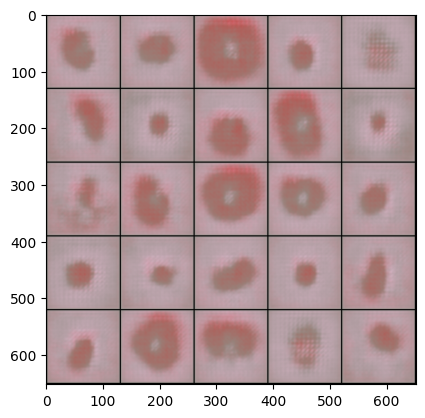

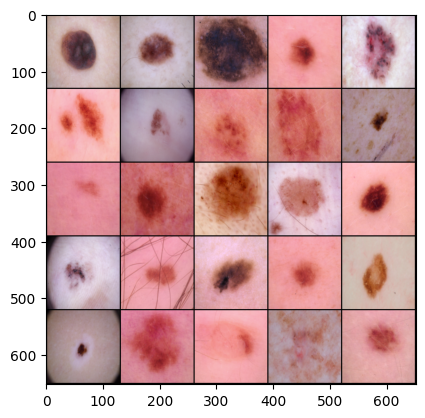

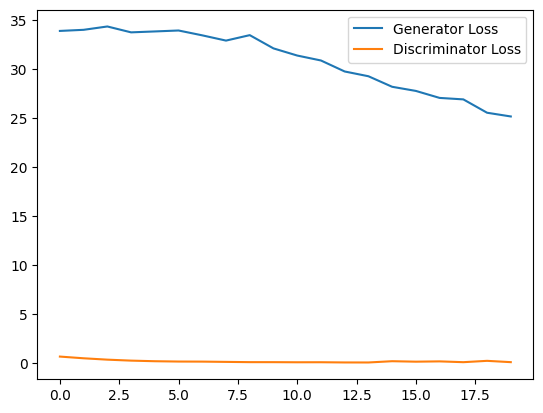

 47%|████▋     | 132/282 [00:32<00:37,  3.98it/s]wandb: WARNING Step only supports monotonically increasing values, use define_metric to set a custom x axis. For details see: https://wandb.me/define-metric
wandb: WARNING (User provided step: 1 is less than current step: 402. Dropping entry: {'inception_score': 2.095290422439575, '_timestamp': 1713057199.3519342}).
  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use

Step 800: Generator loss: 22.567445755004883, discriminator loss: 0.1367378830909729


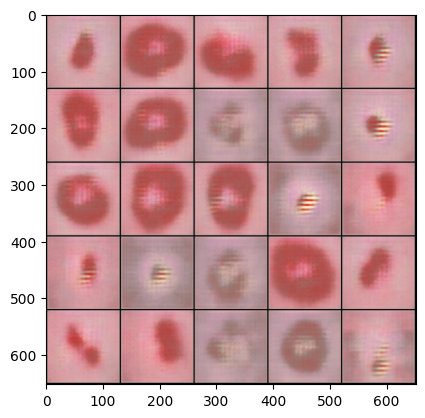

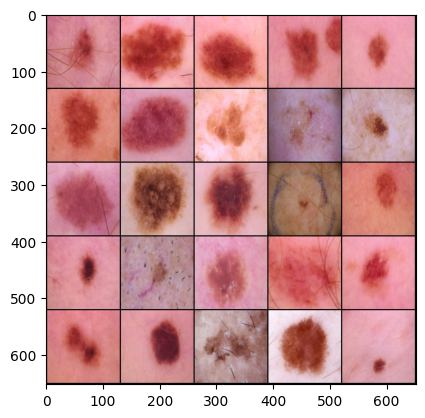

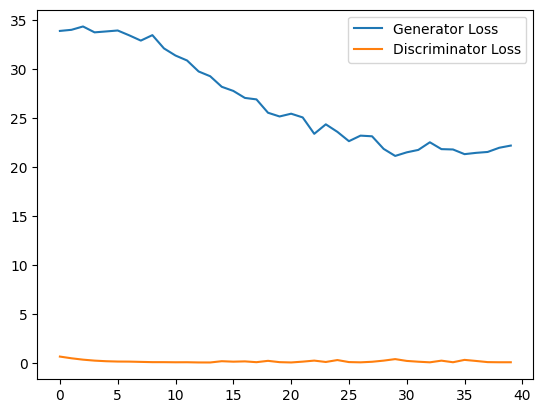

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
  7%|▋         | 19/282 [00:04<00:56,  4.63it/s]wandb: WARNING (User provided step: 2 is less than current step: 802. Dropping entry: {'inception_score': 2.52649188041687, '_timestamp': 1713057292.4155335}).
wandb: WARNING (User provided step: 2 is less than current step: 80

Step 1200: Generator loss: 21.901241302490234, discriminator loss: 0.07962880283594131


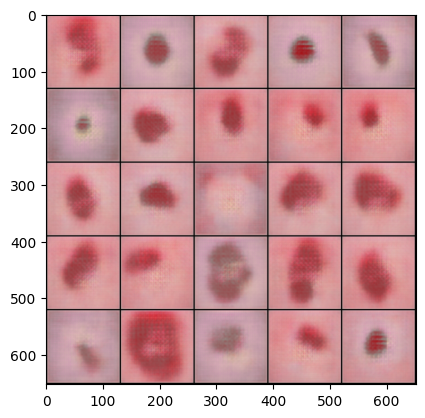

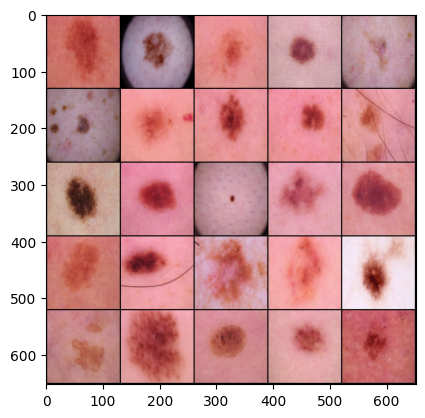

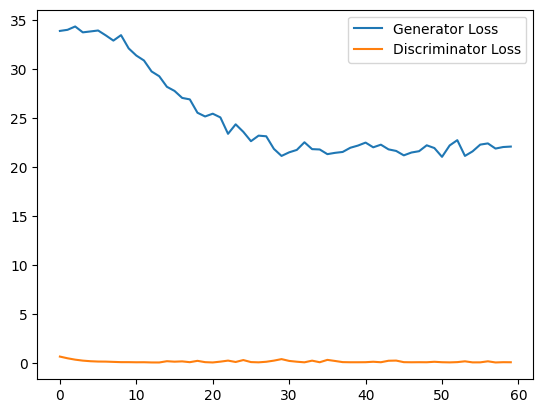

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
 67%|██████▋   | 190/282 [00:48<00:20,  4.55it/s]

Step 1600: Generator loss: 21.107799530029297, discriminator loss: 0.1789087951183319


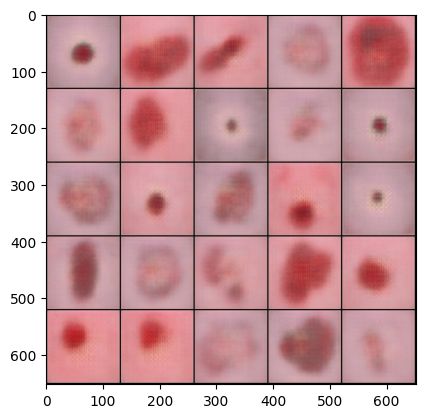

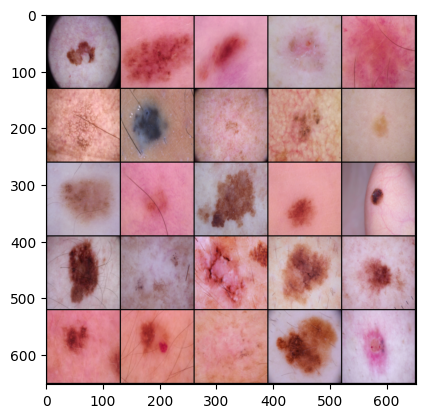

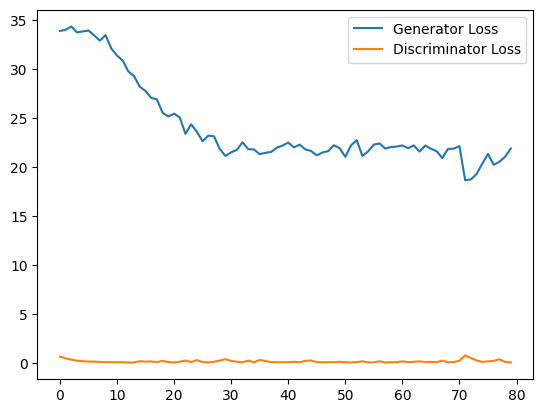

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value b

Step 2000: Generator loss: 20.676105499267578, discriminator loss: 0.3240010440349579


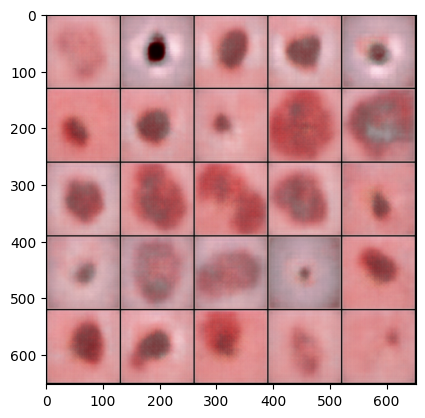

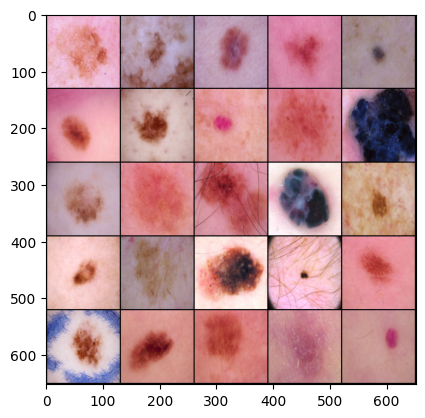

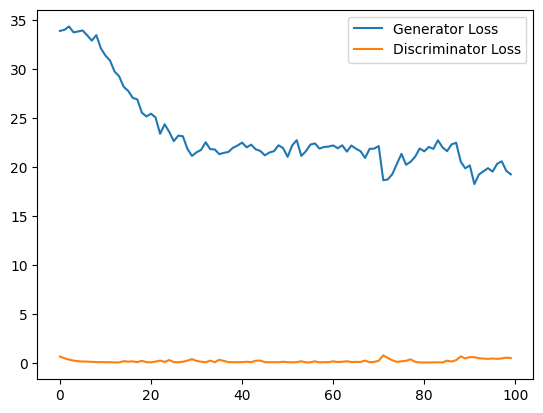

 14%|█▍        | 40/282 [00:12<01:01,  3.93it/s]wandb: WARNING (User provided step: 6 is less than current step: 1602. Dropping entry: {'generator_loss_per_epoch': 20.46653938293457, 'discriminator_loss_per_epoch': 0.6019716858863831, '_timestamp': 1713057579.033968}).
wandb: WARNING (User provided step: 7 is less than current step: 2002. Dropping entry: {'inception_score': 3.1969799995422363, '_timestamp': 1713057589.2140303}).
  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consi

Step 2400: Generator loss: 19.6845645904541, discriminator loss: 0.4484494924545288


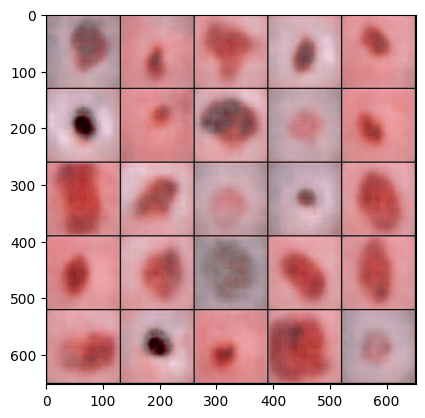

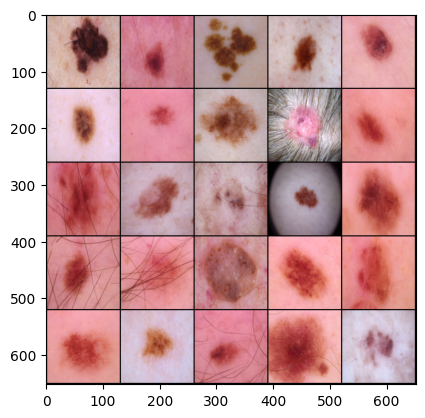

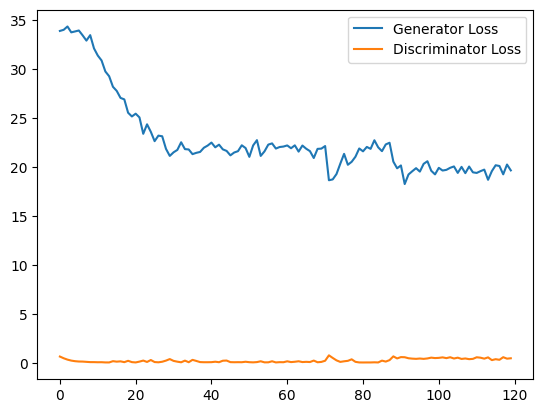

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
 93%|█████████▎| 261/282 [00:59<00:04,  4.47it/s]

Step 2800: Generator loss: 19.55849266052246, discriminator loss: 0.45759138464927673


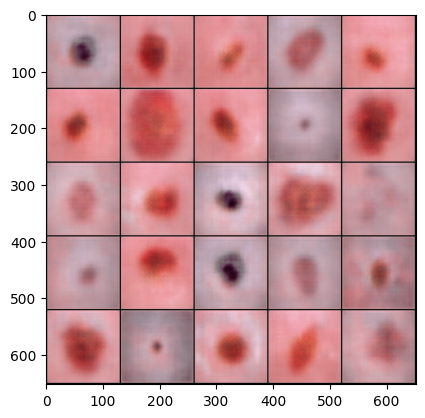

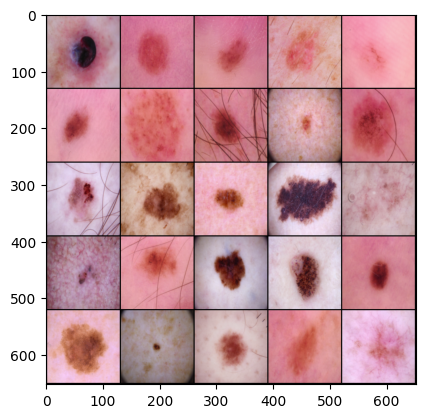

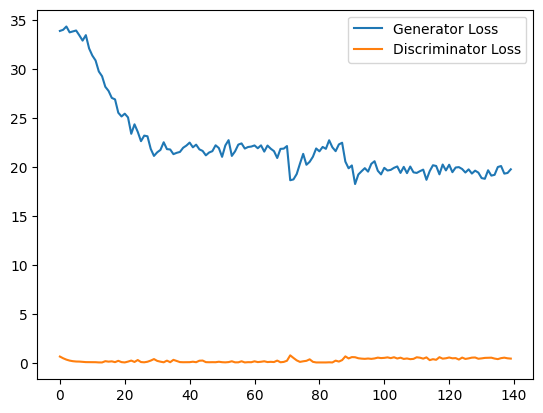

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
  9%|▉         | 25/282 [00:05<00:55,  4.59it/s]wandb: WARNING (User provided step: 9 is less than current step: 2802. Dropping entry: {'inception_score': 2.8815817832946777, '_timestamp': 1713057776.7550292}).
wandb: WARNING (User provided step: 9 is less than current step:

Step 3200: Generator loss: 18.932193756103516, discriminator loss: 0.5101672410964966


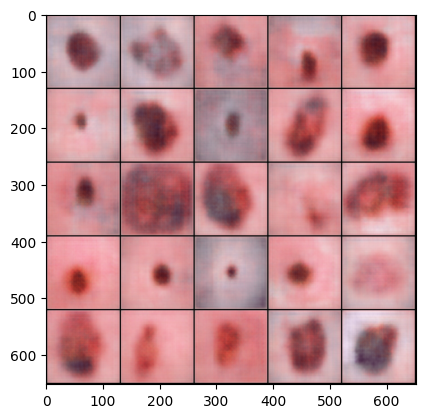

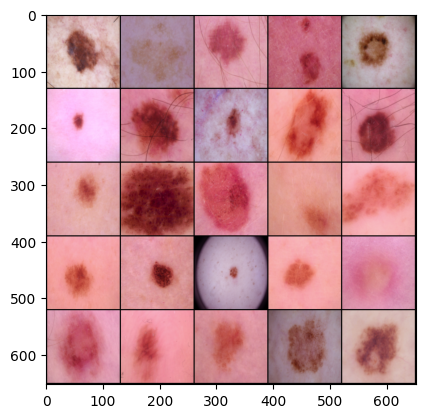

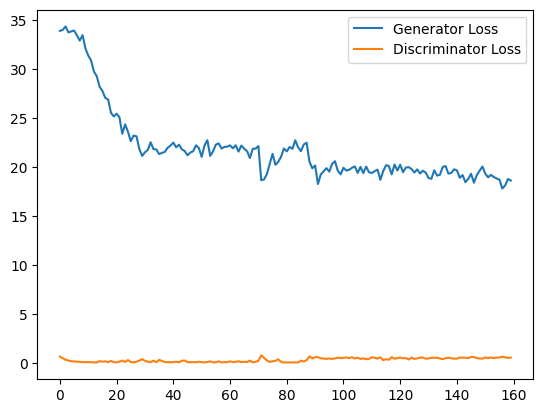

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
 76%|███████▌  | 215/282 [00:48<00:15,  4.37it/s]

Step 3600: Generator loss: 18.503307342529297, discriminator loss: 0.5409238338470459


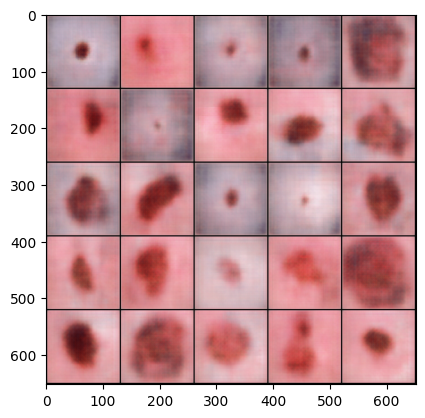

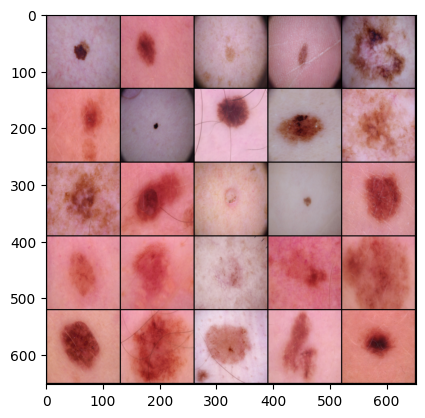

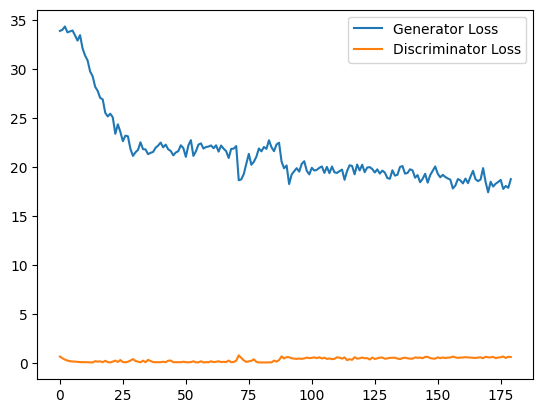

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value b

Step 4000: Generator loss: 17.817859649658203, discriminator loss: 0.5633201003074646


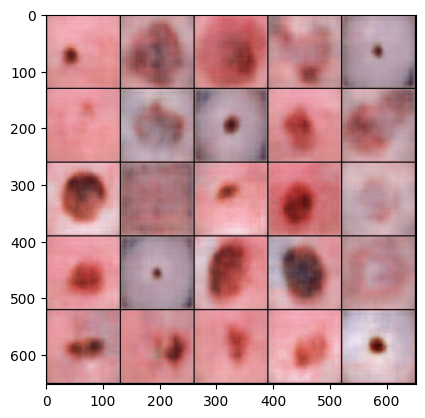

wandb: WARNING (User provided step: 13 is less than current step: 3602. Dropping entry: {'generator_loss_per_epoch': 16.024045944213867, 'discriminator_loss_per_epoch': 0.6254357695579529, '_timestamp': 1713058043.064671}).


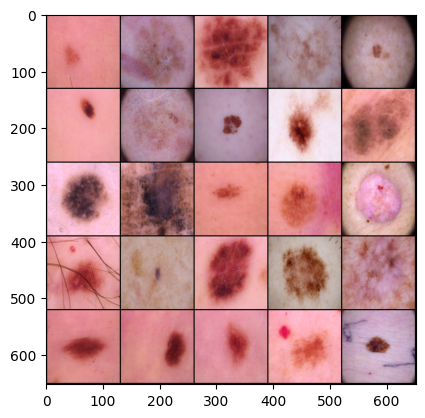

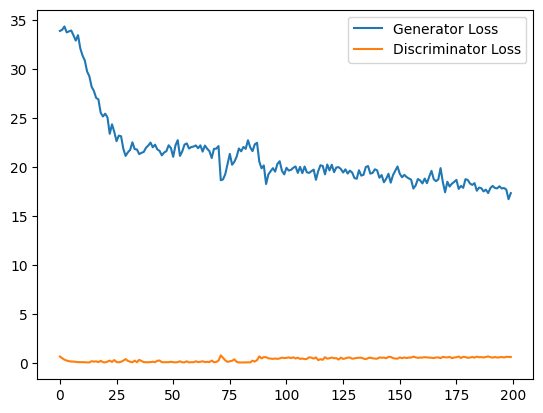

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
 60%|█████▉    | 169/282 [00:41<00:28,  4.02it/s]

Step 4400: Generator loss: 17.234222412109375, discriminator loss: 0.539511501789093


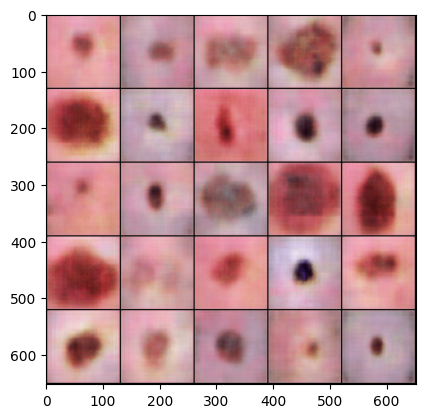

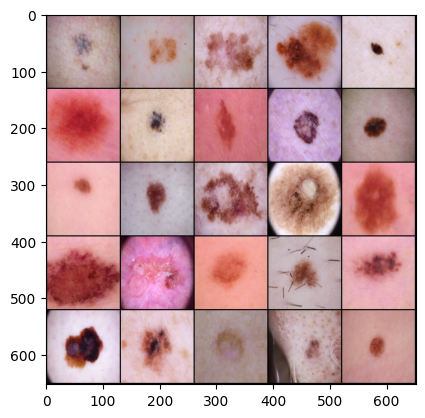

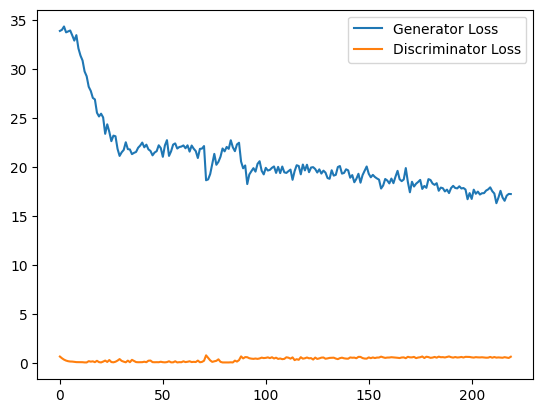

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value b

Step 4800: Generator loss: 16.599199295043945, discriminator loss: 0.561714231967926


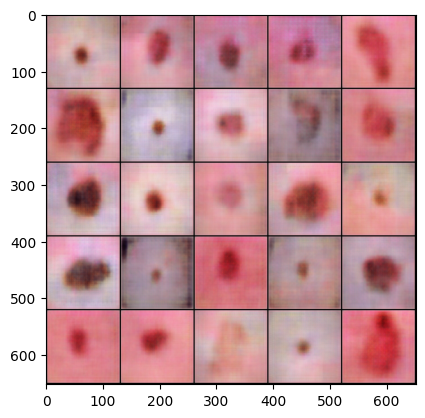

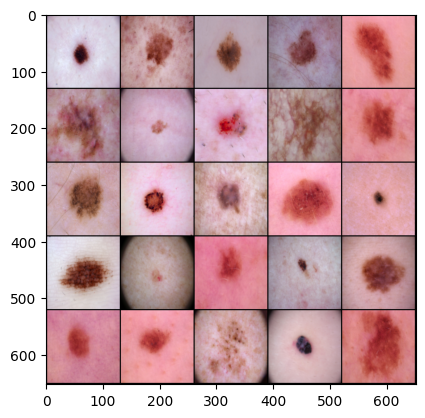

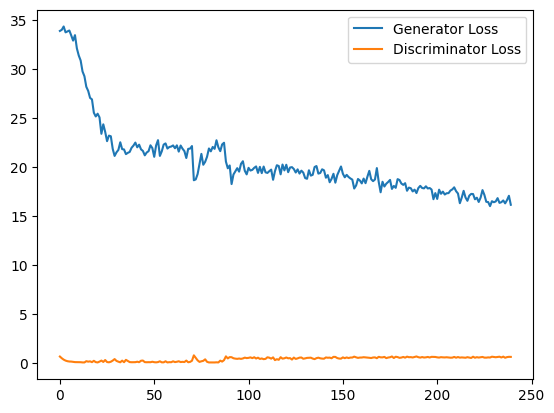

  7%|▋         | 20/282 [00:06<01:05,  4.01it/s]wandb: WARNING (User provided step: 16 is less than current step: 4402. Dropping entry: {'generator_loss_per_epoch': 16.379776000976562, 'discriminator_loss_per_epoch': 0.6300671100616455, '_timestamp': 1713058245.2761674}).
wandb: WARNING (User provided step: 17 is less than current step: 4802. Dropping entry: {'inception_score': 2.8284389972686768, '_timestamp': 1713058249.4602275}).
  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (c

Step 5200: Generator loss: 15.84655475616455, discriminator loss: 0.5857942700386047


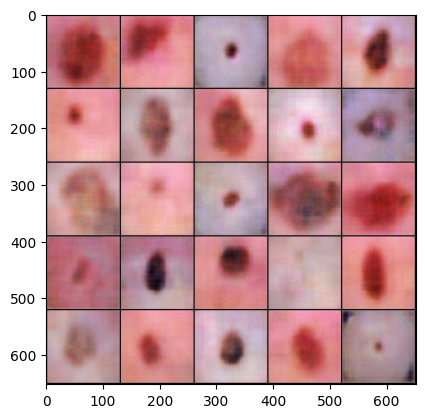

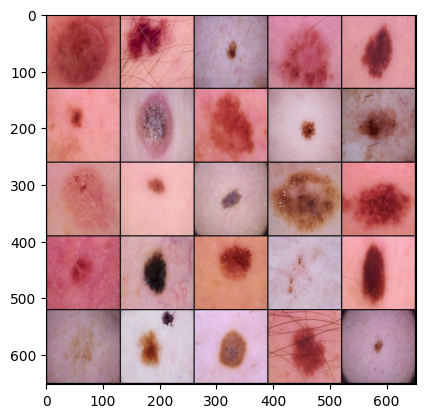

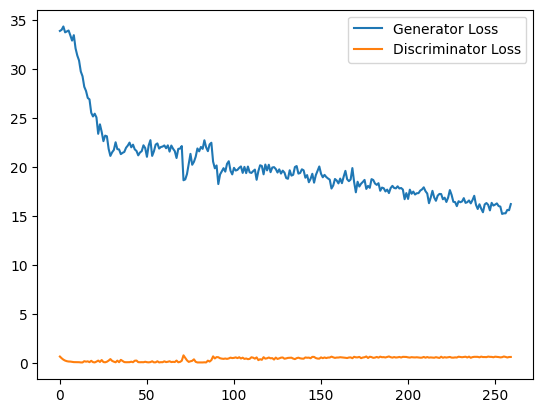

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
 85%|████████▌ | 241/282 [00:55<00:09,  4.51it/s]

Step 5600: Generator loss: 15.321934700012207, discriminator loss: 0.5820322036743164


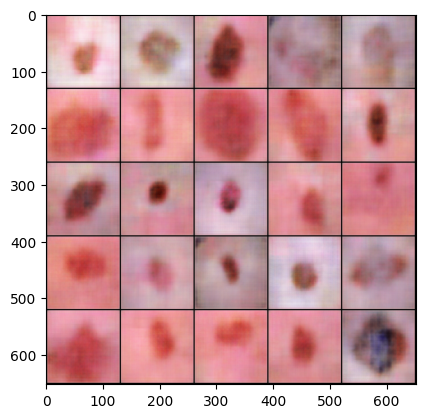

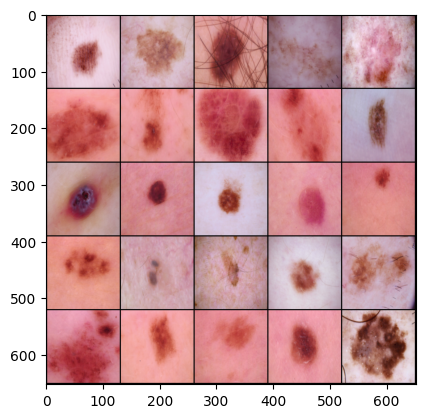

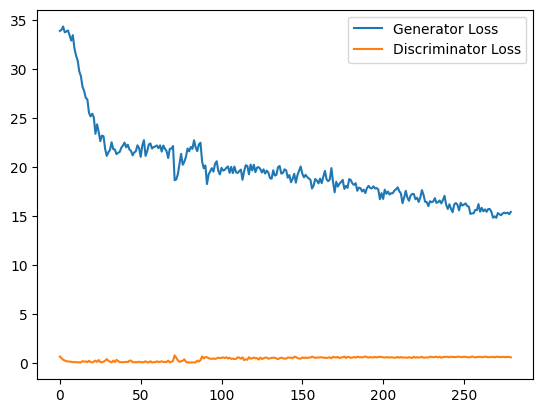

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
  2%|▏         | 7/282 [00:02<01:20,  3.41it/s]wandb: WARNING (User provided step: 19 is less than current step: 5602. Dropping entry: {'inception_score': 3.608898401260376, '_timestamp': 1713058436.2482193}).
wandb: WARNING (User provided step: 19 is less than current step:

Step 6000: Generator loss: 14.74993896484375, discriminator loss: 0.5904043912887573


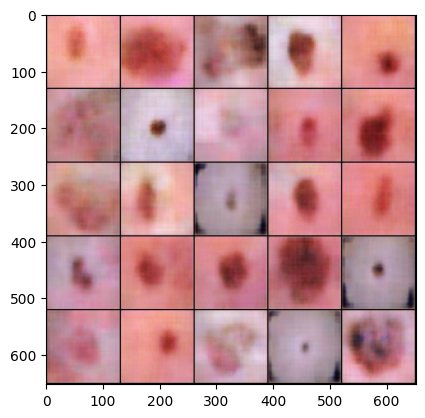

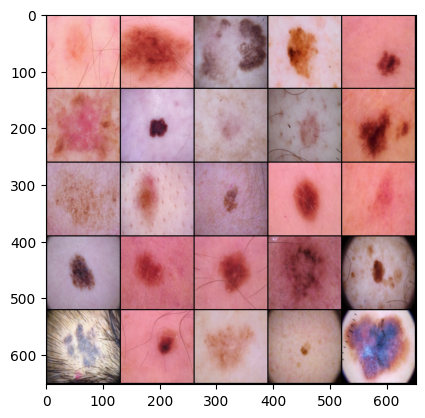

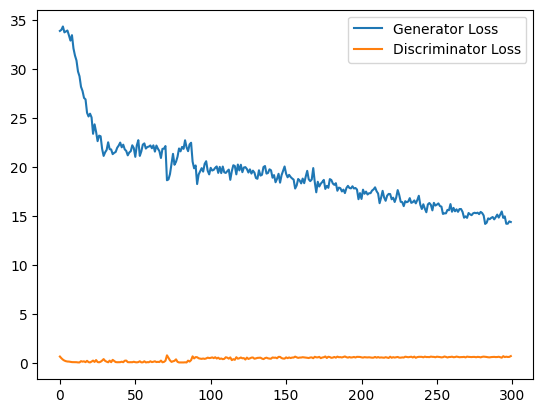

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
 69%|██████▉   | 195/282 [00:45<00:19,  4.52it/s]

Step 6400: Generator loss: 14.365273475646973, discriminator loss: 0.5748572945594788


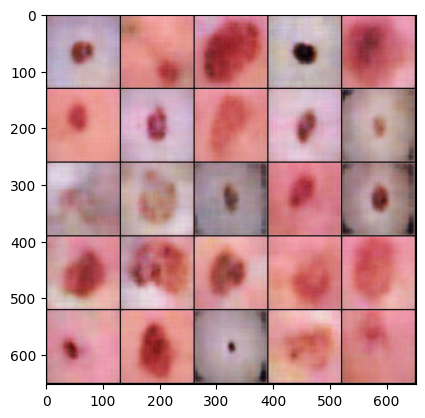

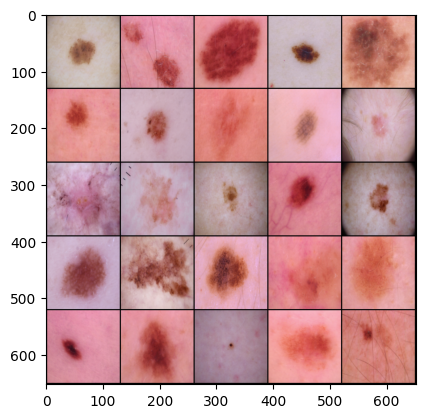

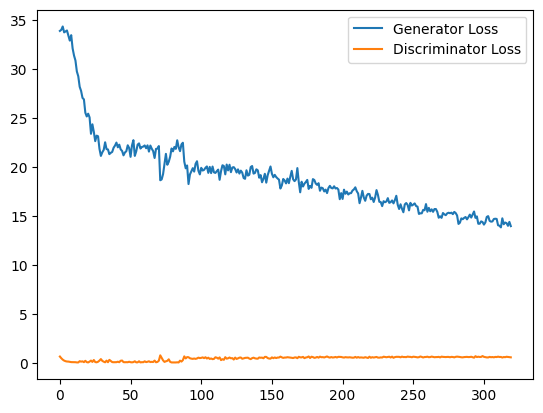

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value b

Step 6800: Generator loss: 13.993291854858398, discriminator loss: 0.5625642538070679


wandb: WARNING (User provided step: 23 is less than current step: 6402. Dropping entry: {'generator_loss_per_epoch': 15.890134811401367, 'discriminator_loss_per_epoch': 0.48646682500839233, '_timestamp': 1713058708.321044}).


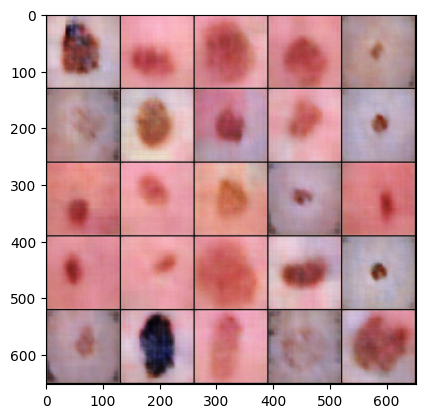

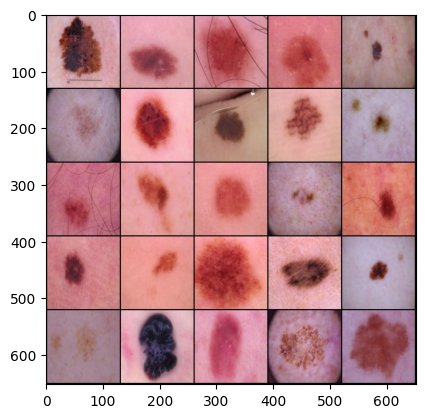

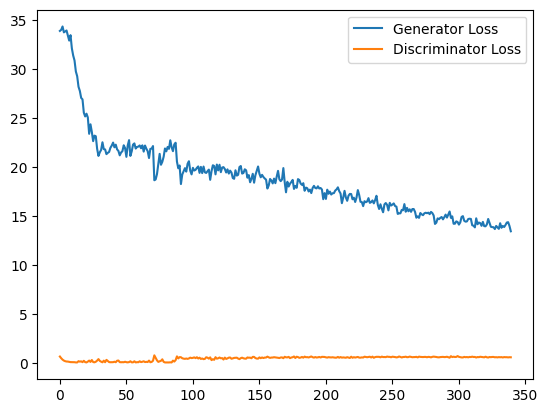

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
 53%|█████▎    | 150/282 [00:33<00:28,  4.60it/s]

Step 7200: Generator loss: 13.778705596923828, discriminator loss: 0.5318166017532349


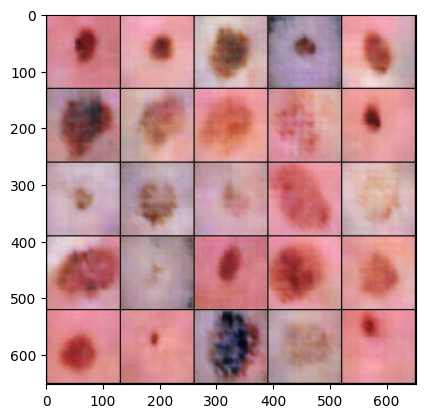

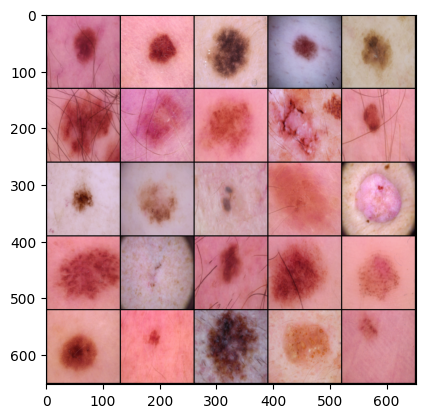

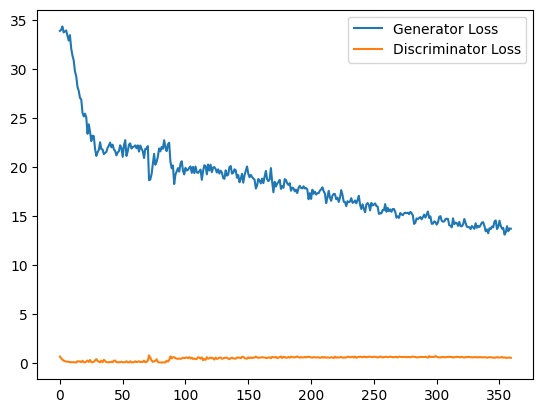

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
 95%|█████████▍| 267/282 [01:02<00:03,  4.38it/s]

Step 7600: Generator loss: 13.87430477142334, discriminator loss: 0.48257583379745483


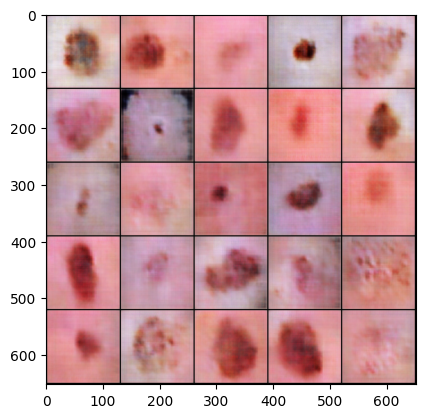

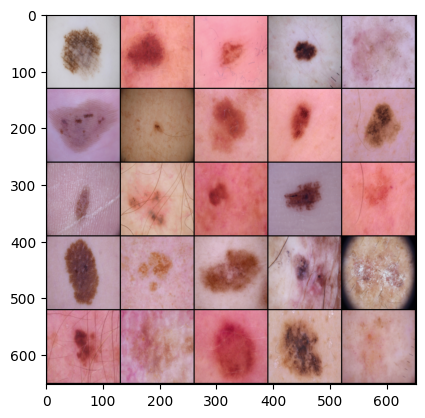

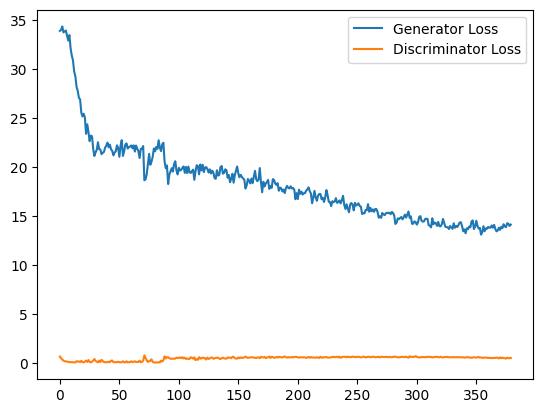

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
  4%|▍         | 11/282 [00:02<01:05,  4.11it/s]wandb: WARNING (User provided step: 26 is less than current step: 7602. Dropping entry: {'inception_score': 3.395575523376465, '_timestamp': 1713058905.9865558}).
wandb: WARNING (User provided step: 26 is less than current step

Step 8000: Generator loss: 13.772342681884766, discriminator loss: 0.46450403332710266


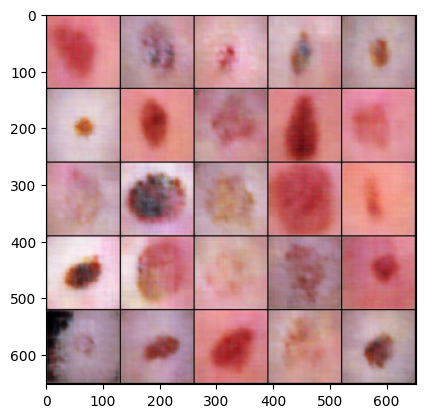

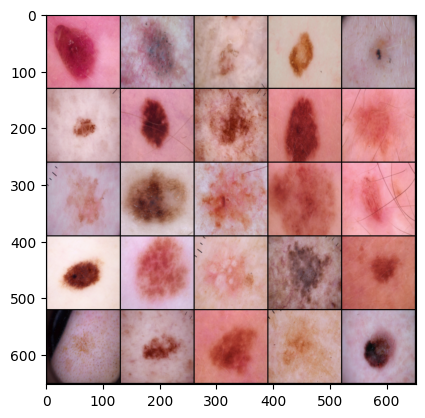

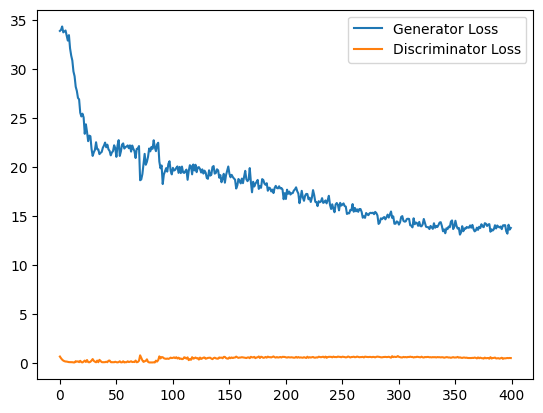

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
 79%|███████▊  | 222/282 [01:03<00:14,  4.10it/s]

Step 8400: Generator loss: 13.822535514831543, discriminator loss: 0.450647234916687


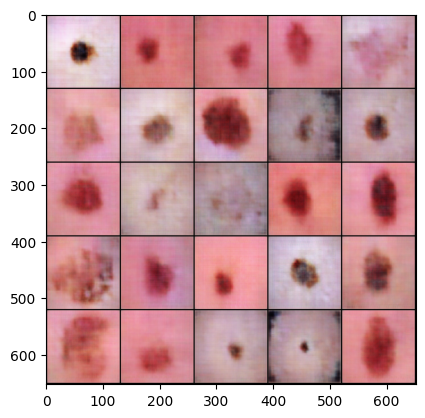

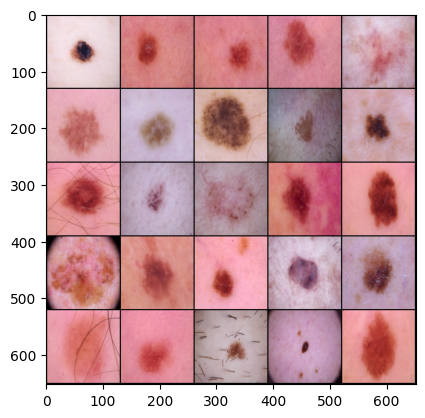

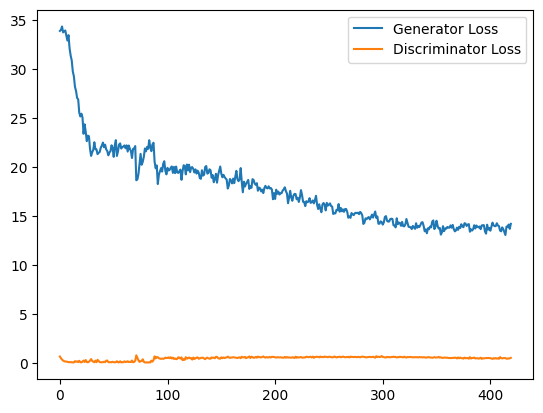

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value b

Step 8800: Generator loss: 13.777523040771484, discriminator loss: 0.4420253336429596


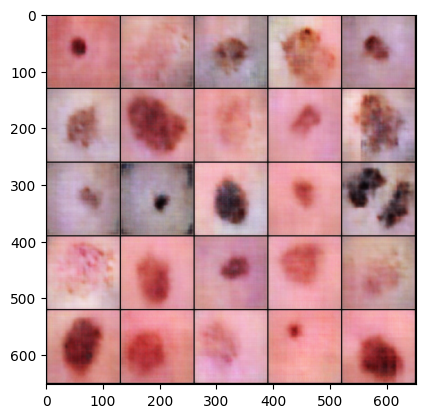

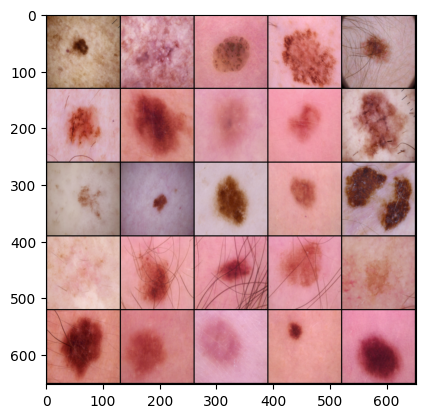

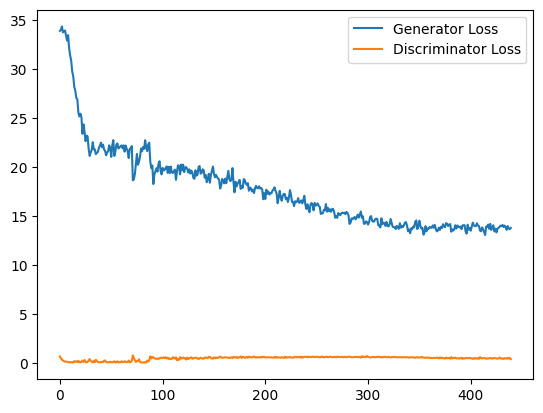

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
 62%|██████▏   | 175/282 [00:42<00:24,  4.32it/s]

Step 9200: Generator loss: 13.661601066589355, discriminator loss: 0.44083186984062195


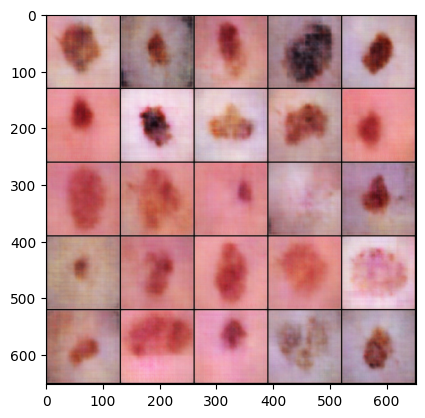

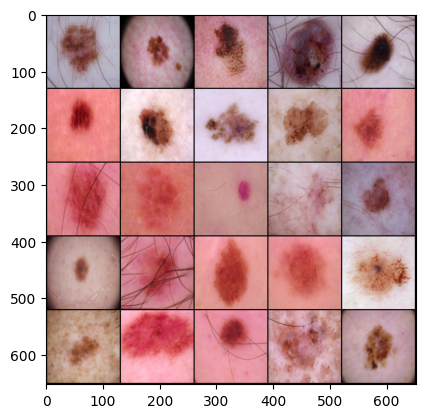

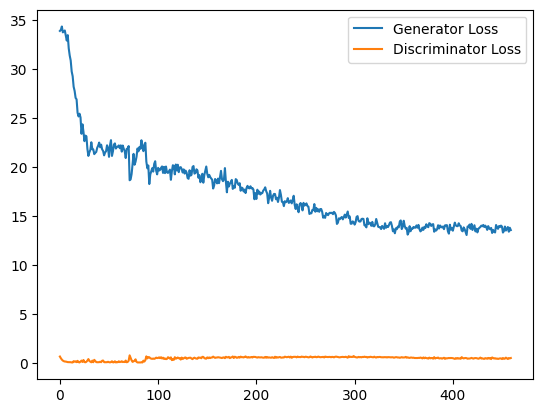

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value b

Step 9600: Generator loss: 13.788196563720703, discriminator loss: 0.4298308491706848


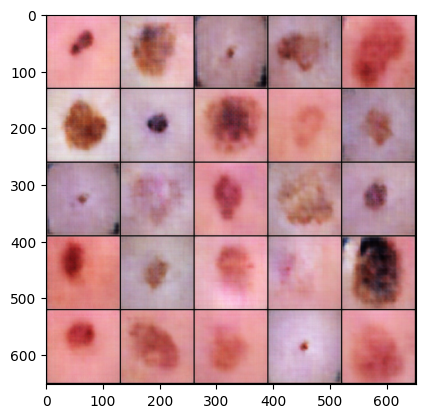

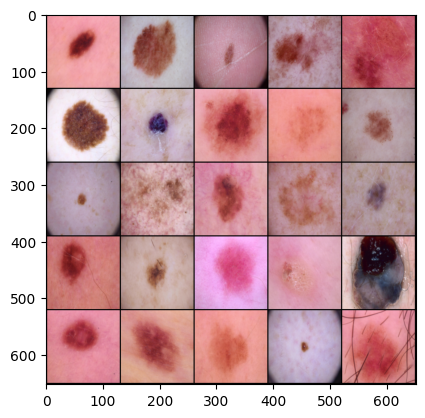

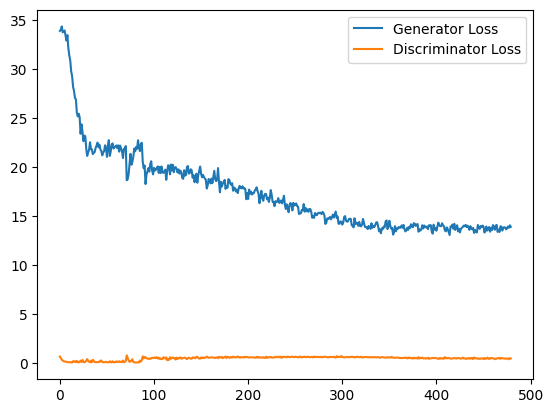

  9%|▊         | 24/282 [00:09<01:18,  3.28it/s]wandb: WARNING (User provided step: 33 is less than current step: 9202. Dropping entry: {'generator_loss_per_epoch': 15.366186141967773, 'discriminator_loss_per_epoch': 0.20805445313453674, '_timestamp': 1713059412.5994282}).
wandb: WARNING (User provided step: 34 is less than current step: 9602. Dropping entry: {'inception_score': 3.7761268615722656, '_timestamp': 1713059419.3096502}).
  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (

Step 10000: Generator loss: 13.623998641967773, discriminator loss: 0.4358735680580139


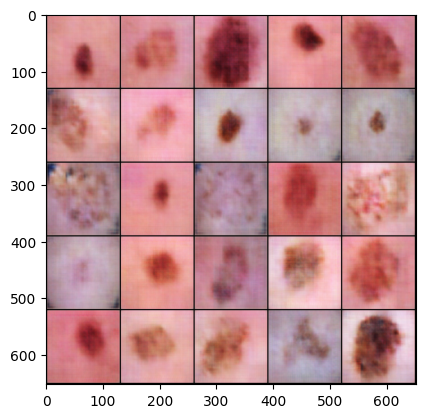

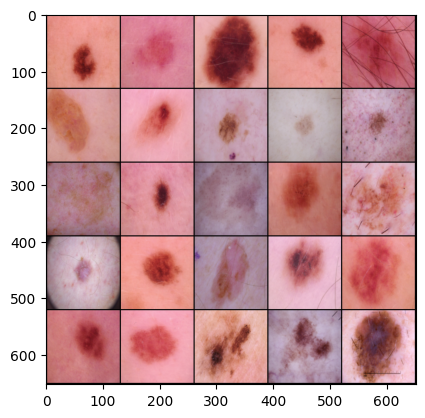

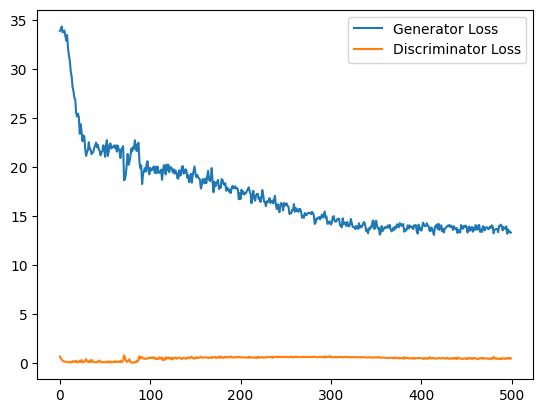

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
 88%|████████▊ | 247/282 [01:00<00:07,  4.47it/s]

Step 10400: Generator loss: 13.593073844909668, discriminator loss: 0.4468045234680176


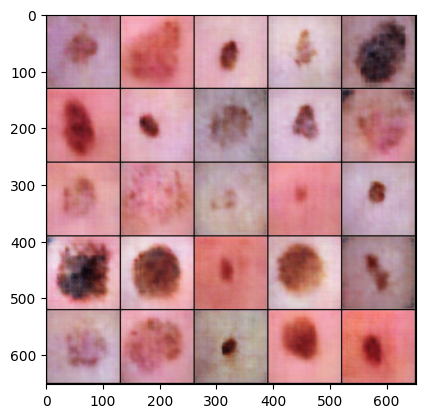

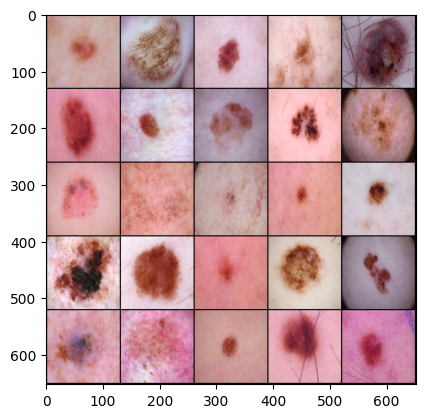

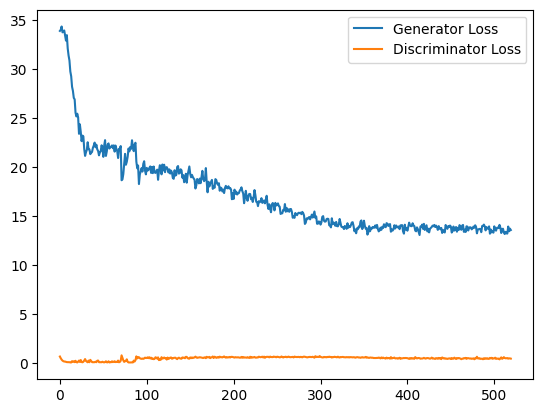

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
  1%|          | 3/282 [00:01<02:28,  1.88it/s]wandb: WARNING (User provided step: 36 is less than current step: 10402. Dropping entry: {'inception_score': 3.4688258171081543, '_timestamp': 1713059636.461964}).
wandb: WARNING (User provided step: 36 is less than current step

Step 10800: Generator loss: 13.506081581115723, discriminator loss: 0.45025211572647095


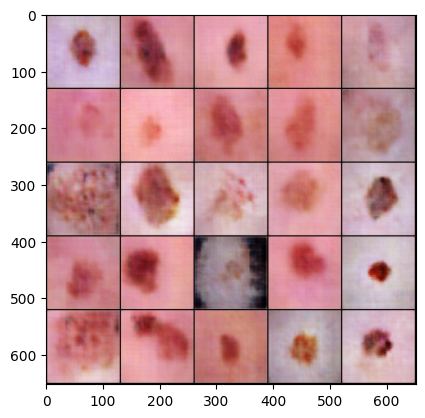

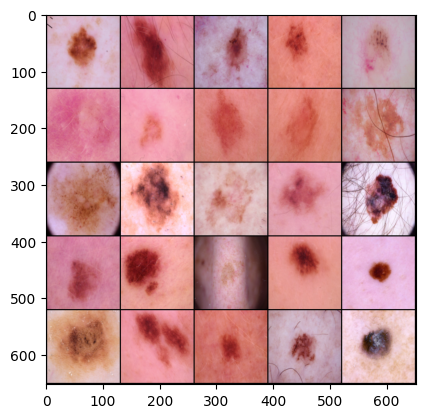

wandb: WARNING (User provided step: 38 is less than current step: 10802. Dropping entry: {'inception_score': 2.7953410148620605, '_timestamp': 1713059736.6753862}).


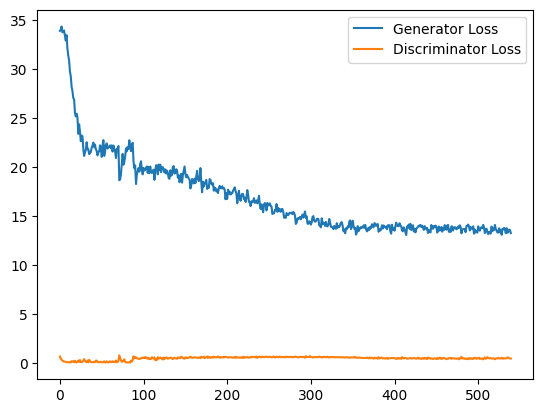

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
 72%|███████▏  | 202/282 [00:48<00:16,  4.86it/s]

Step 11200: Generator loss: 13.337250709533691, discriminator loss: 0.4603367745876312


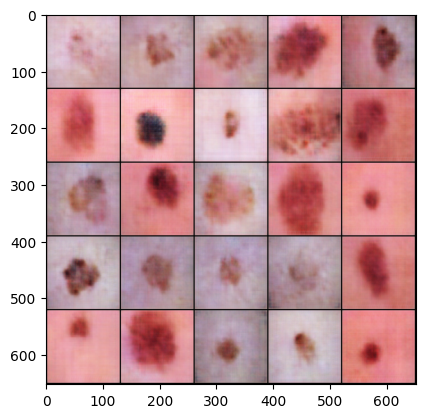

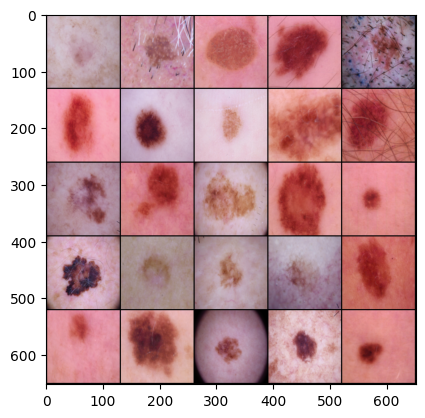

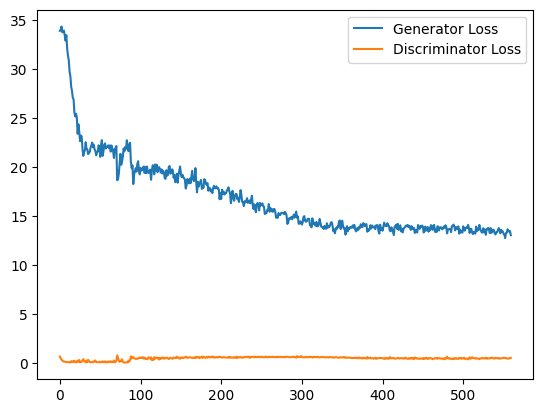

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value b

Step 11600: Generator loss: 13.35633373260498, discriminator loss: 0.4659814238548279


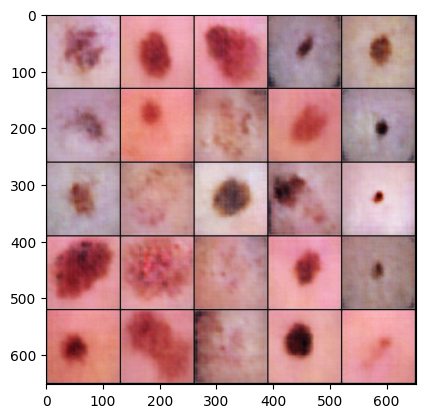

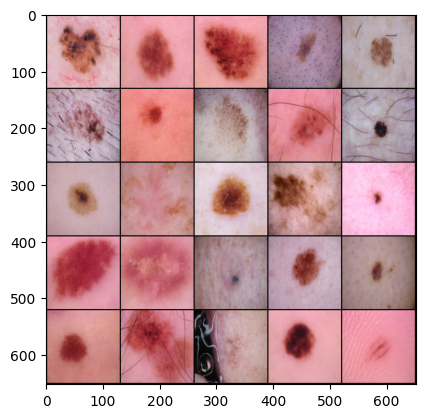

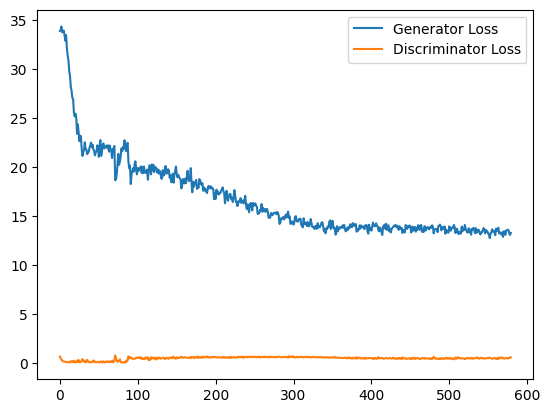

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
 55%|█████▌    | 156/282 [00:37<00:26,  4.72it/s]

Step 12000: Generator loss: 13.080562591552734, discriminator loss: 0.46420881152153015


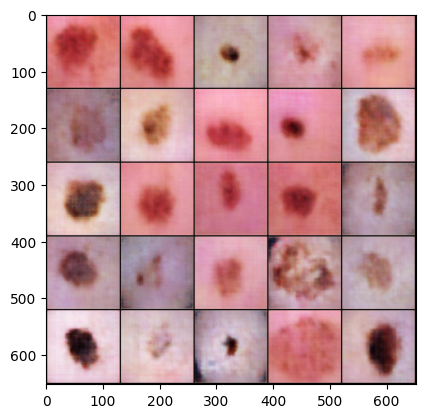

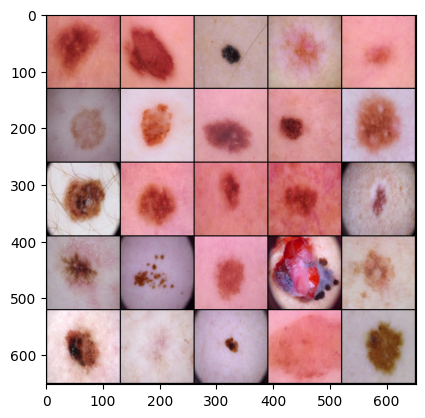

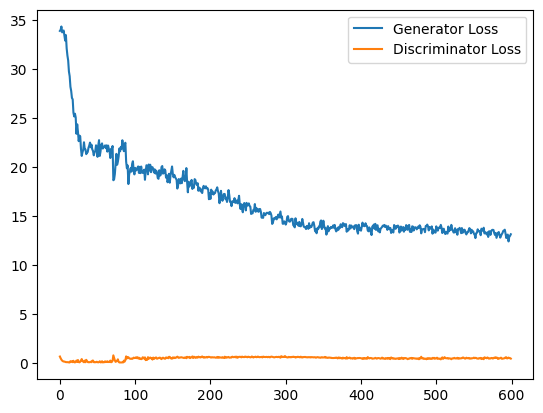

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
 97%|█████████▋| 273/282 [01:07<00:02,  4.16it/s]

Step 12400: Generator loss: 13.176040649414062, discriminator loss: 0.46057525277137756


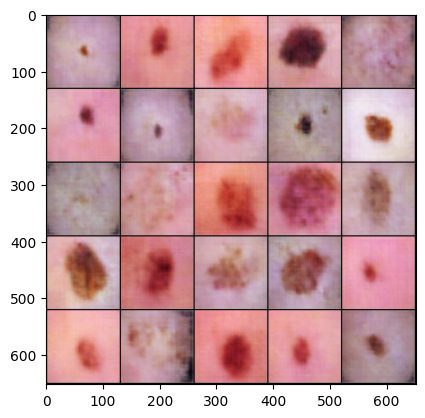

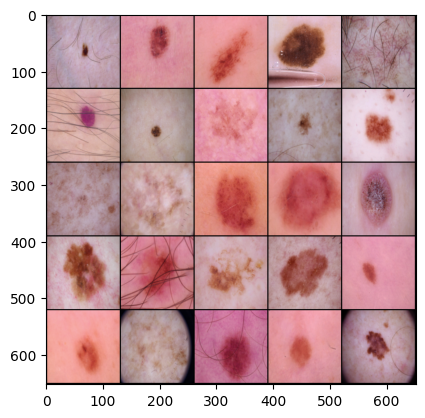

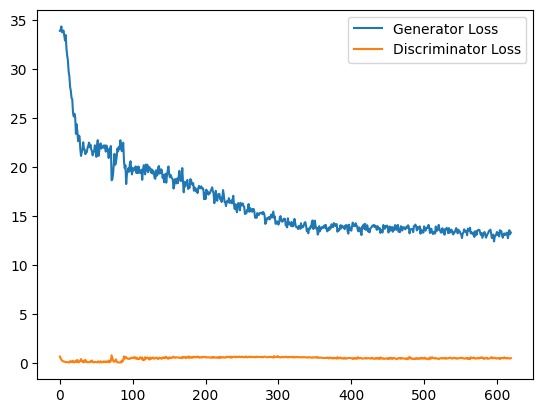

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
  5%|▌         | 15/282 [00:03<01:01,  4.33it/s]wandb: WARNING (User provided step: 43 is less than current step: 12402. Dropping entry: {'inception_score': 3.6919424533843994, '_timestamp': 1713060136.8763537}).
wandb: WARNING (User provided step: 43 is less than current st

Step 12800: Generator loss: 12.999905586242676, discriminator loss: 0.4740370213985443


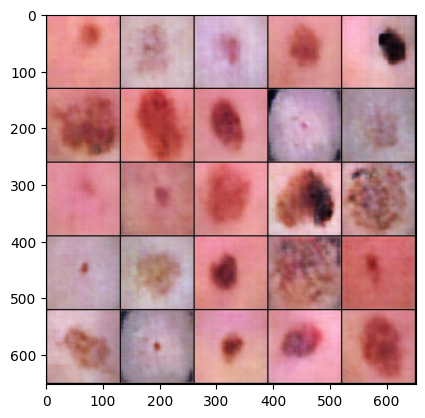

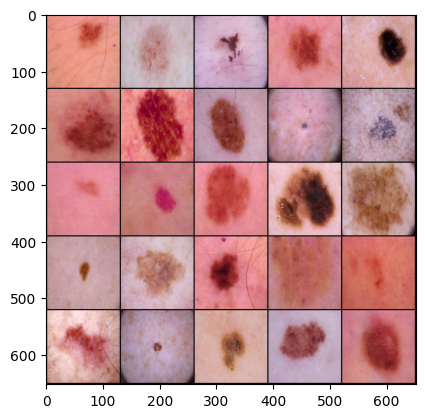

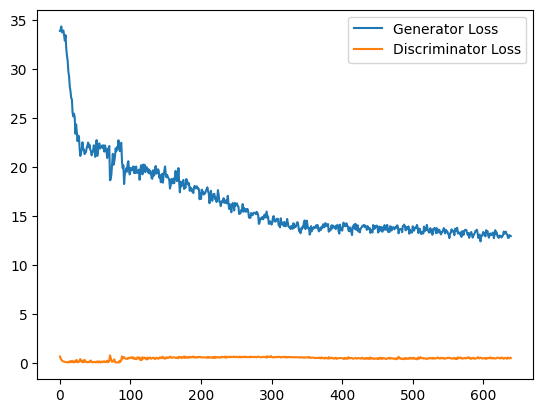

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
 80%|████████  | 227/282 [00:56<00:12,  4.27it/s]

Step 13200: Generator loss: 13.057064056396484, discriminator loss: 0.4685021936893463


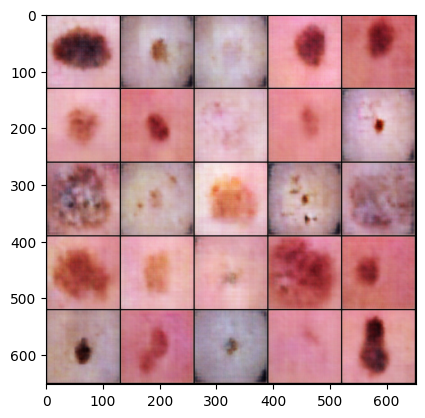

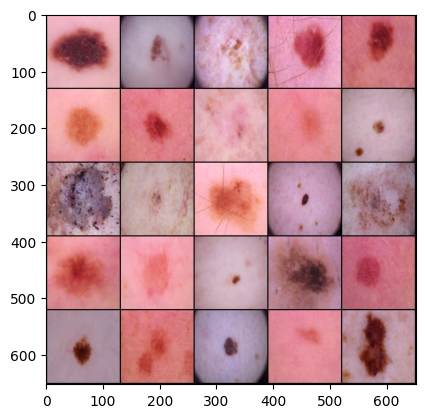

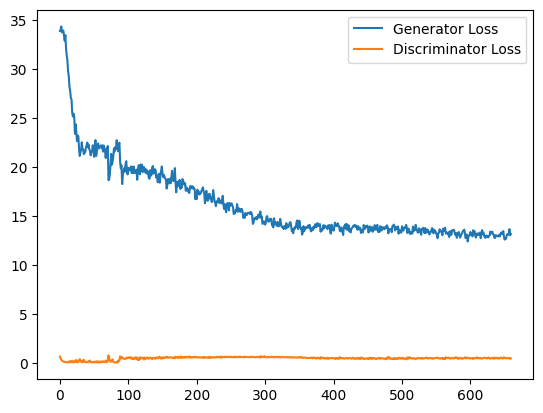

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value b

Step 13600: Generator loss: 12.95136547088623, discriminator loss: 0.4661329984664917


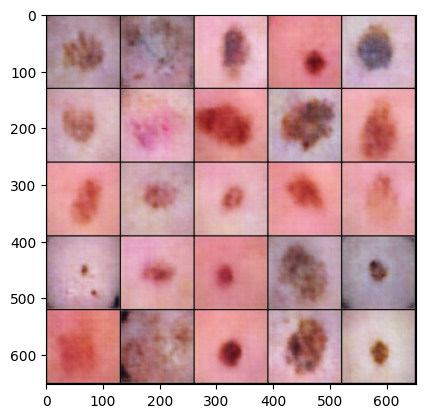

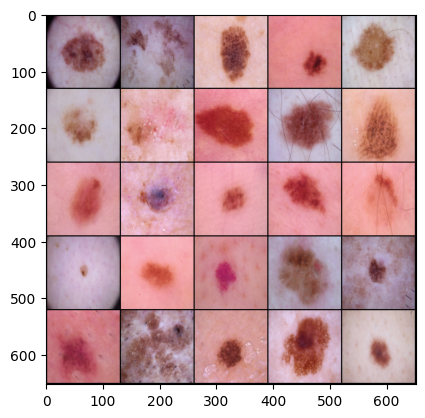

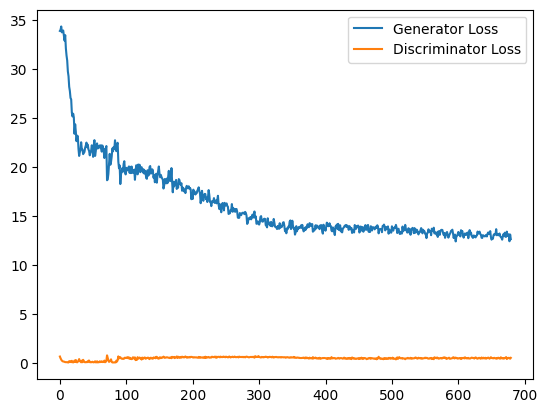

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
 64%|██████▍   | 181/282 [00:46<00:34,  2.89it/s]

Step 14000: Generator loss: 13.020421028137207, discriminator loss: 0.4639427065849304


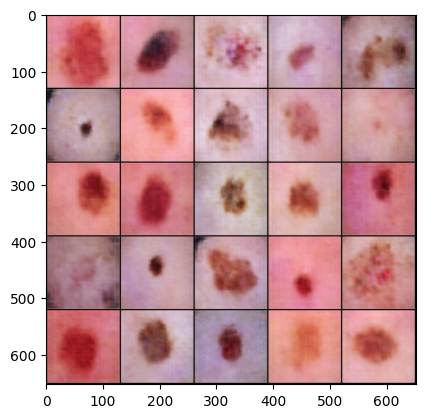

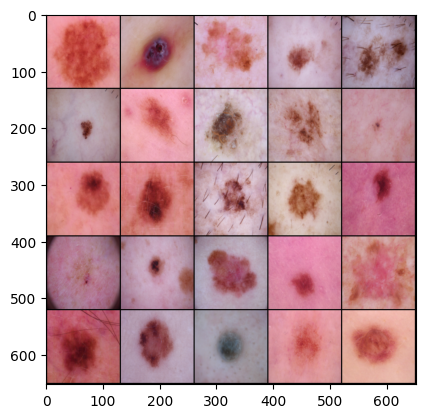

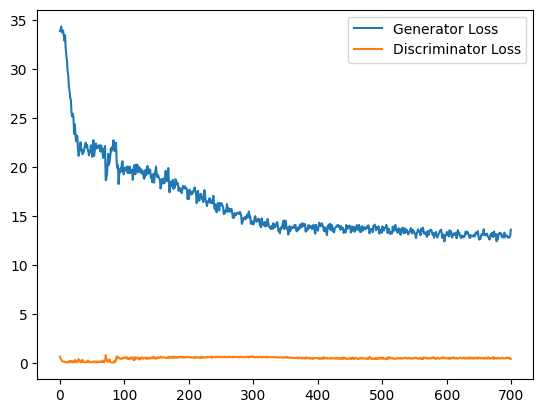

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value b

Step 14400: Generator loss: 12.885224342346191, discriminator loss: 0.4745789170265198


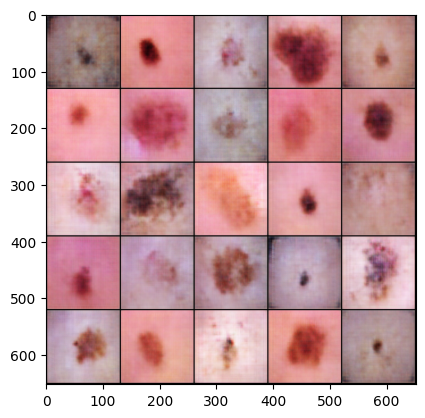

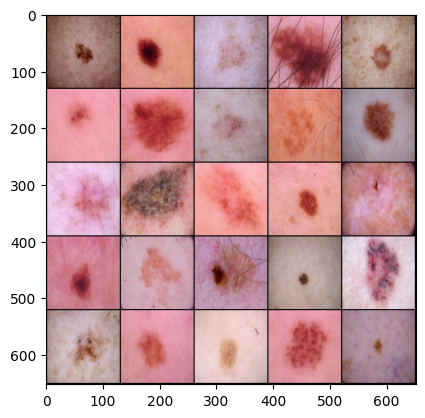

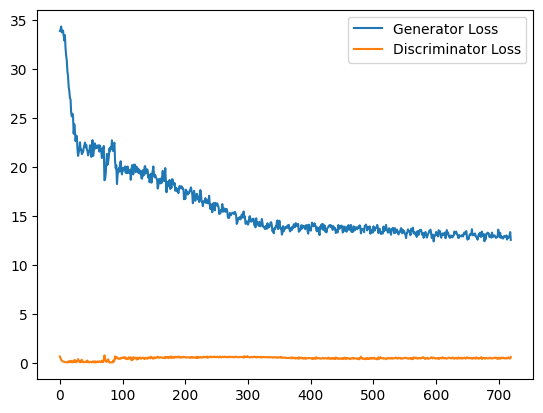

 16%|█▋        | 46/282 [00:13<00:52,  4.45it/s]wandb: WARNING (User provided step: 50 is less than current step: 14002. Dropping entry: {'generator_loss_per_epoch': 12.140190124511719, 'discriminator_loss_per_epoch': 0.6887716054916382, '_timestamp': 1713060638.4450312}).
wandb: WARNING (User provided step: 51 is less than current step: 14402. Dropping entry: {'inception_score': 3.2429423332214355, '_timestamp': 1713060645.8188505}).
  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels 

Step 14800: Generator loss: 12.851601600646973, discriminator loss: 0.46748438477516174


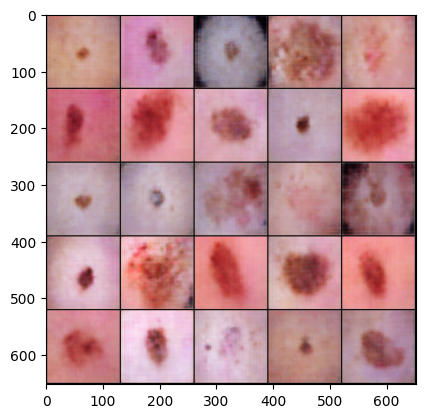

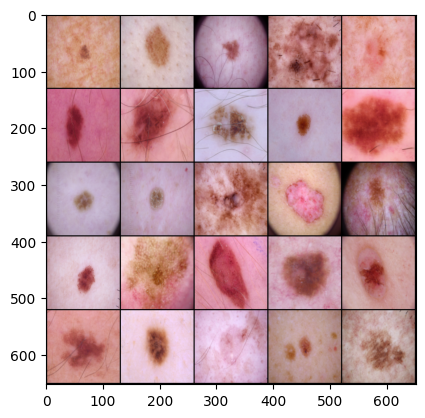

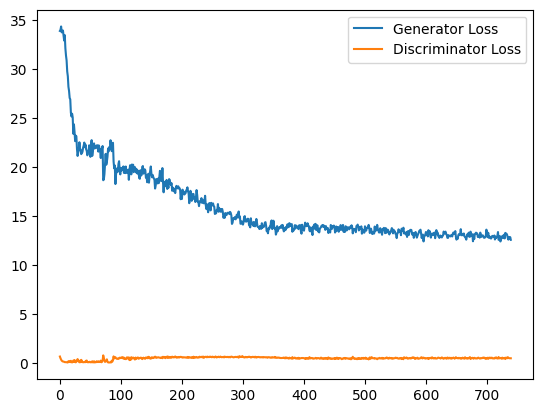

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
 90%|█████████ | 254/282 [01:03<00:06,  4.44it/s]

Step 15200: Generator loss: 12.787336349487305, discriminator loss: 0.4832354485988617


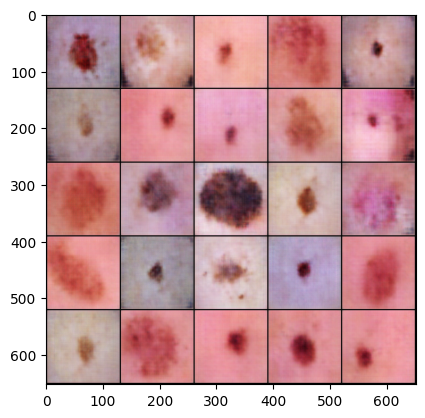

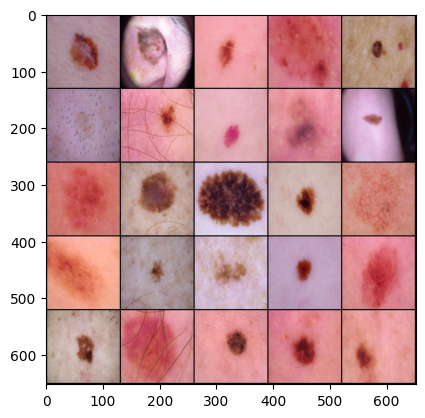

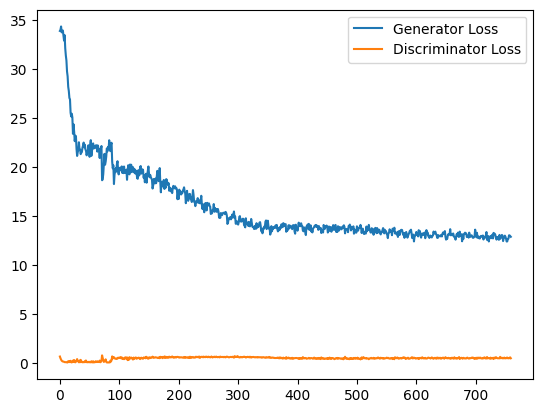

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value b

Step 15600: Generator loss: 12.690553665161133, discriminator loss: 0.46341976523399353


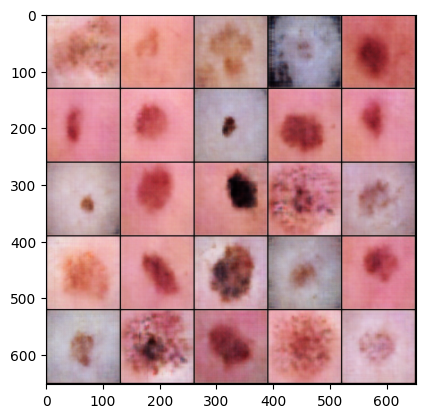

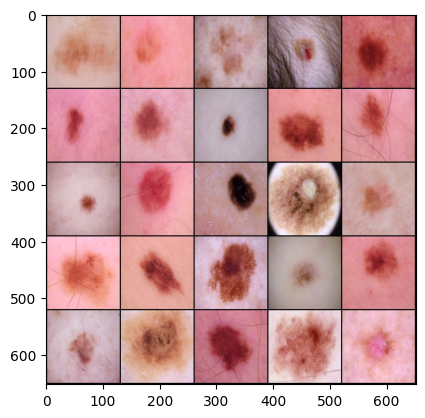

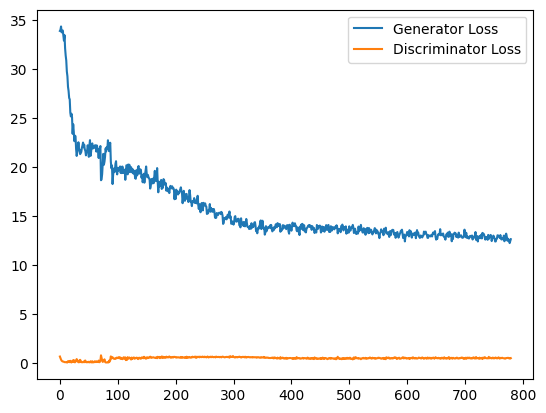

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
 74%|███████▍  | 208/282 [00:52<00:32,  2.28it/s]

Step 16000: Generator loss: 12.78254508972168, discriminator loss: 0.4680848717689514


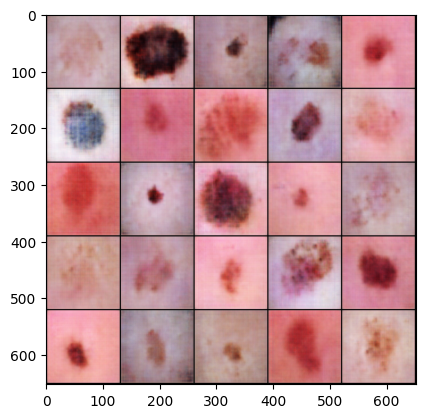

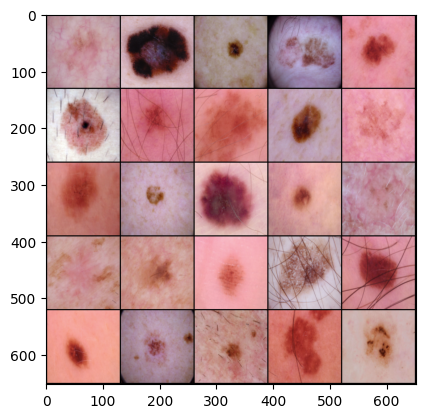

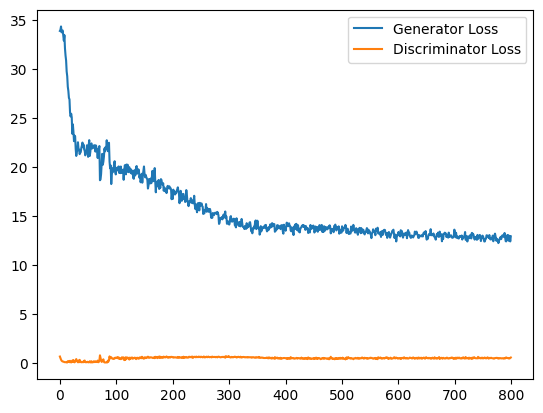

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value b

Step 16400: Generator loss: 12.637642860412598, discriminator loss: 0.4800437092781067


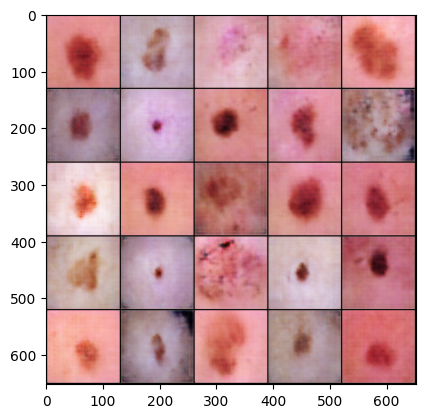

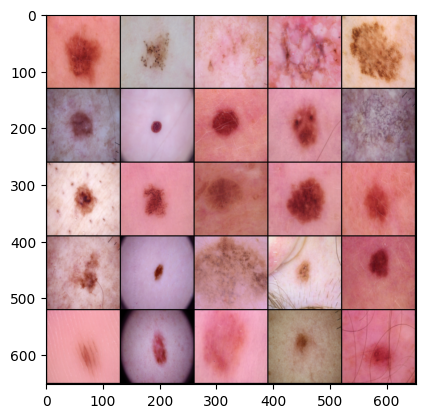

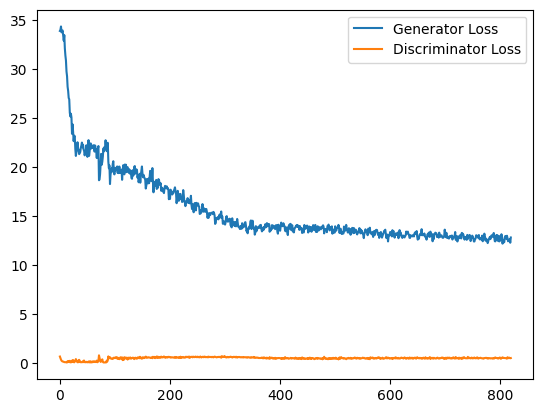

 18%|█▊        | 50/282 [00:14<01:41,  2.28it/s]wandb: WARNING (User provided step: 57 is less than current step: 16002. Dropping entry: {'generator_loss_per_epoch': 12.162999153137207, 'discriminator_loss_per_epoch': 0.47684523463249207, '_timestamp': 1713061237.3455248}).
wandb: WARNING (User provided step: 58 is less than current step: 16402. Dropping entry: {'inception_score': 3.9697206020355225, '_timestamp': 1713061250.4151213}).
  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels

Step 16800: Generator loss: 12.460916519165039, discriminator loss: 0.49260684847831726


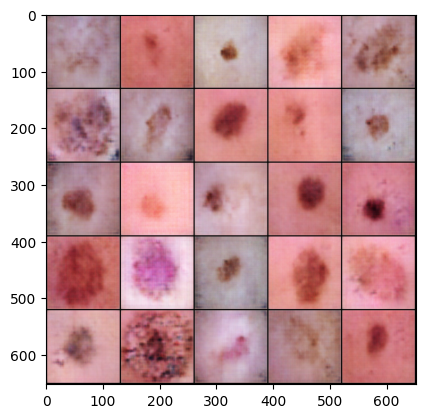

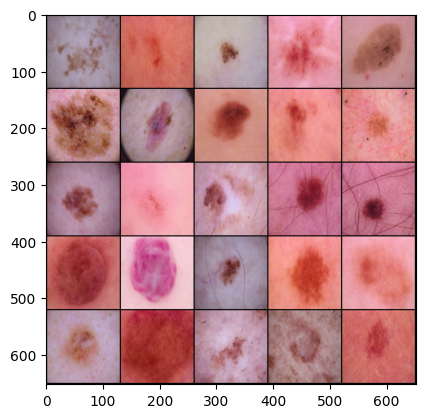

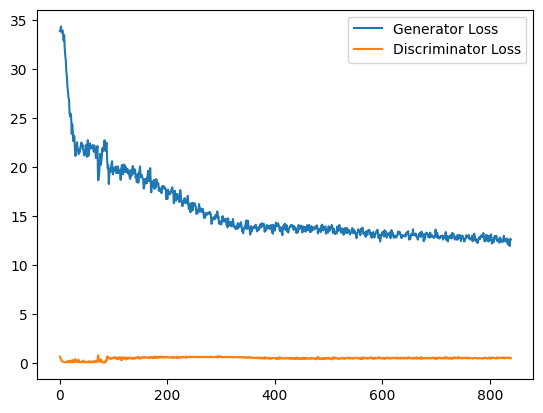

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
 99%|█████████▉| 279/282 [01:04<00:00,  4.19it/s]

Step 17200: Generator loss: 12.570466995239258, discriminator loss: 0.4666954576969147


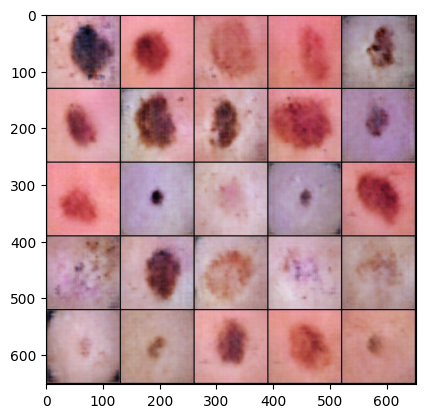

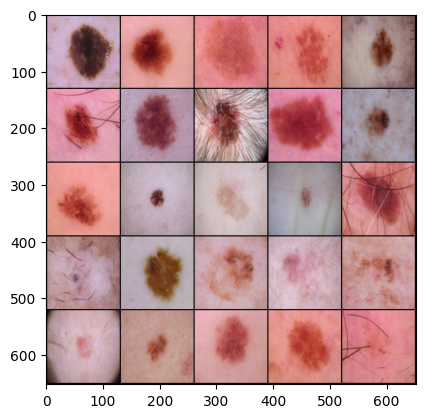

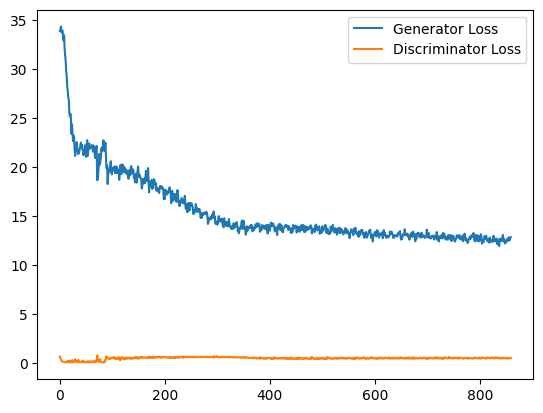

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
  8%|▊         | 23/282 [00:05<00:58,  4.46it/s]wandb: WARNING (User provided step: 60 is less than current step: 17202. Dropping entry: {'inception_score': 3.3488340377807617, '_timestamp': 1713061440.4514372}).
wandb: WARNING (User provided step: 60 is less than current st

Step 17600: Generator loss: 12.634295463562012, discriminator loss: 0.46549803018569946


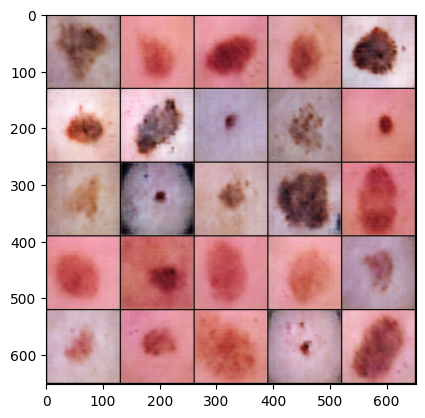

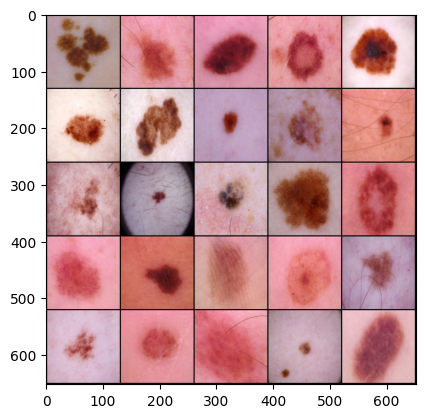

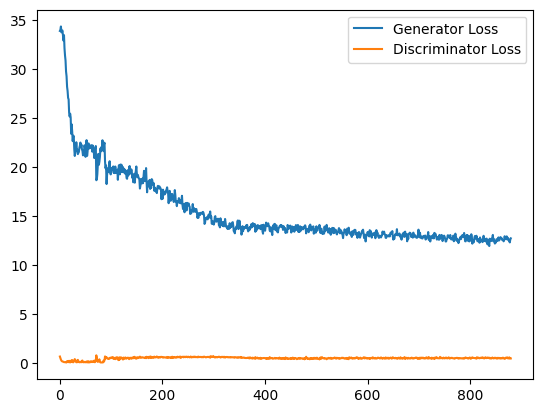

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
wandb: WARNING (User provided step: 62 is less than current step: 17602. Dropping entry: {'generator_loss_per_epoch': 12.03398323059082, 'discriminator_loss_per_epoch': 0.5572863817214966, '_timestamp': 1713061581.5910974}).
 83%|████████▎ | 234/282 [00:54<00:11,  4.35it/s]

Step 18000: Generator loss: 12.648895263671875, discriminator loss: 0.46833616495132446


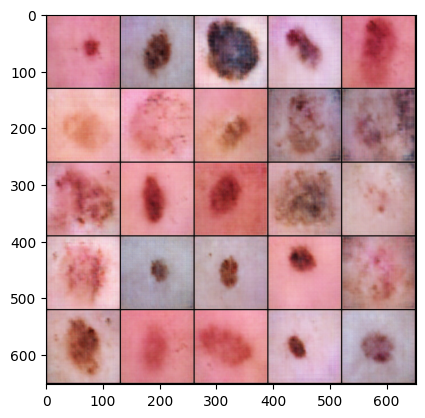

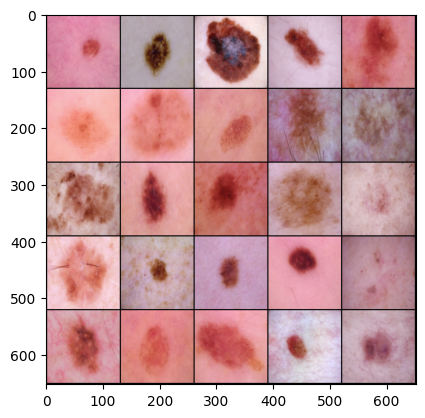

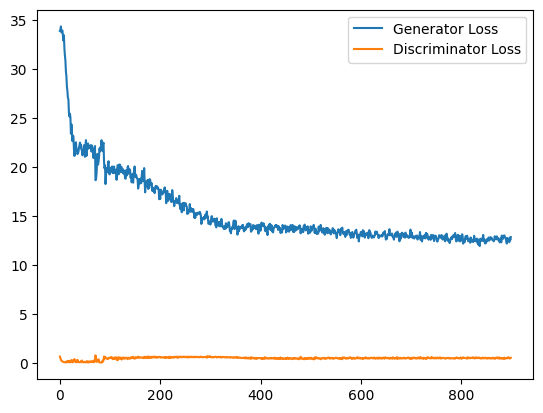

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value b

Step 18400: Generator loss: 12.458331108093262, discriminator loss: 0.48756083846092224


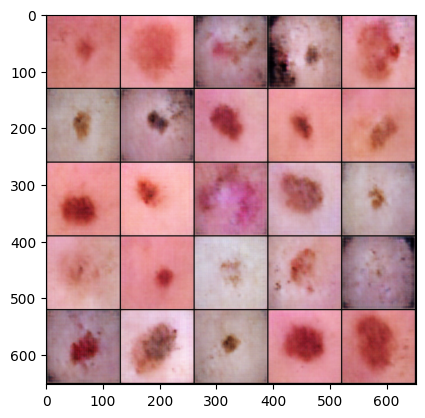

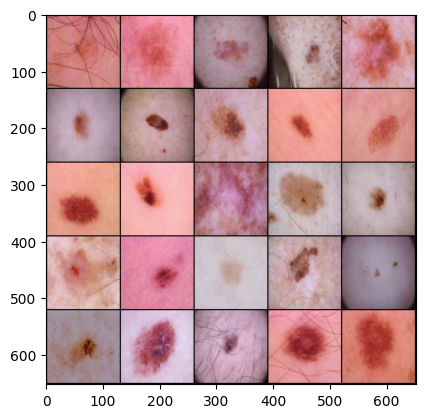

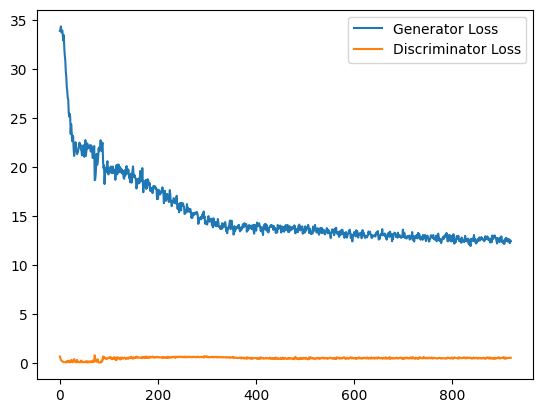

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
 67%|██████▋   | 188/282 [00:43<00:20,  4.50it/s]

Step 18800: Generator loss: 12.400874137878418, discriminator loss: 0.47698652744293213


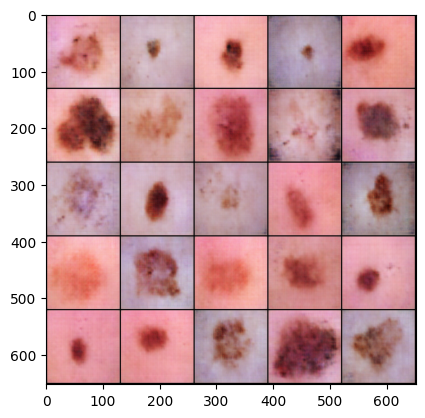

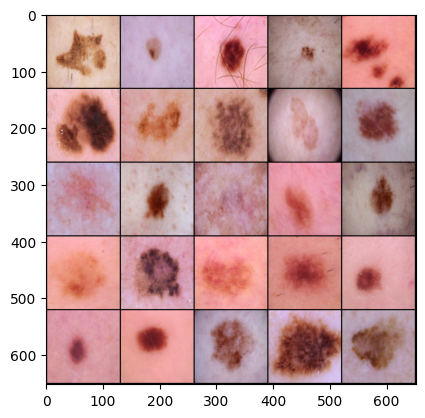

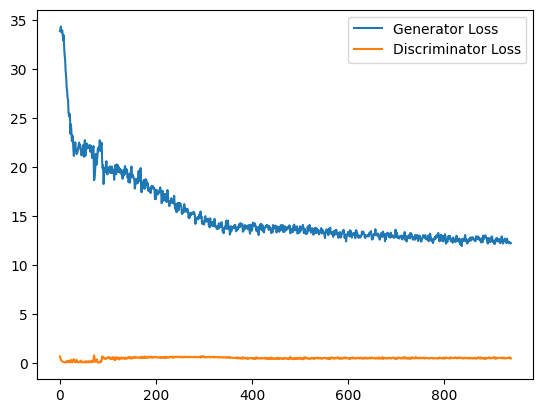

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value b

Step 19200: Generator loss: 12.372776985168457, discriminator loss: 0.4813231825828552


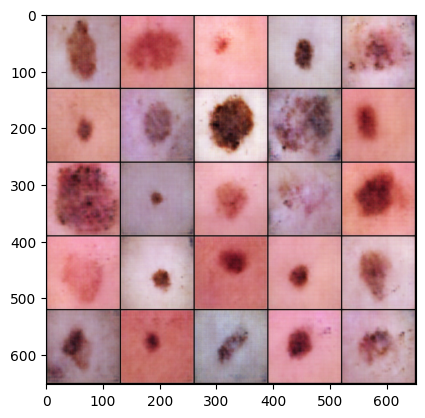

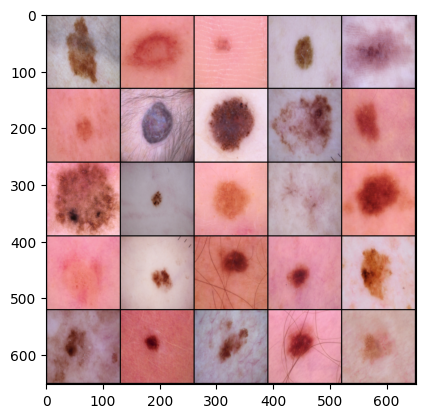

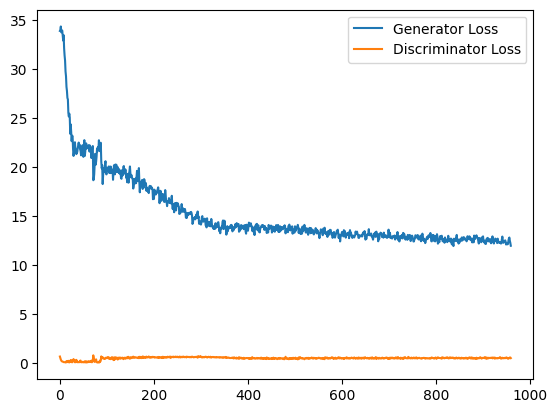

 16%|█▌        | 44/282 [00:13<00:57,  4.11it/s]wandb: WARNING (User provided step: 67 is less than current step: 18802. Dropping entry: {'generator_loss_per_epoch': 12.629788398742676, 'discriminator_loss_per_epoch': 0.4092276692390442, '_timestamp': 1713061913.8708112}).
wandb: WARNING (User provided step: 68 is less than current step: 19202. Dropping entry: {'inception_score': 3.4589617252349854, '_timestamp': 1713061922.722752}).
  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (

Step 19600: Generator loss: 12.311347007751465, discriminator loss: 0.4876664876937866


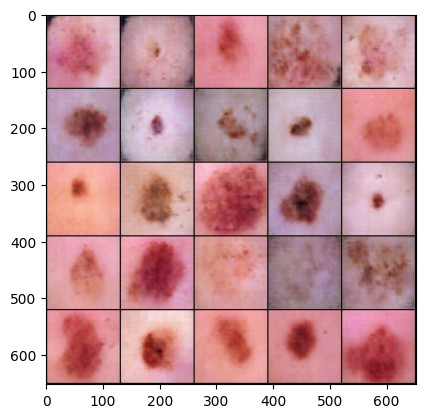

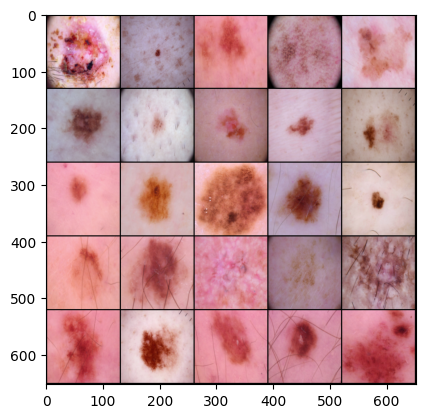

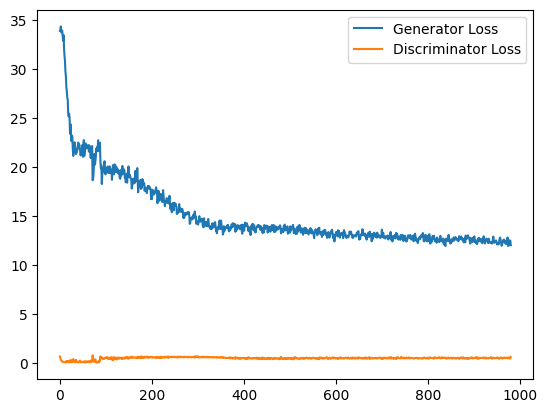

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
 92%|█████████▏| 260/282 [00:59<00:04,  4.86it/s]

Step 20000: Generator loss: 12.338480949401855, discriminator loss: 0.47787246108055115


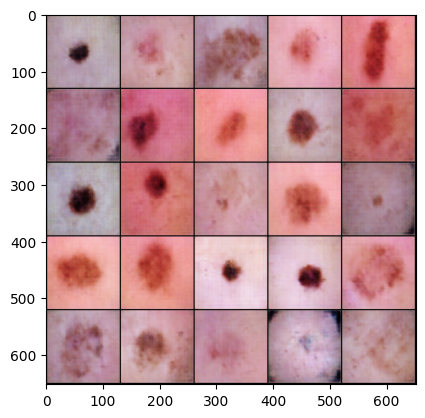

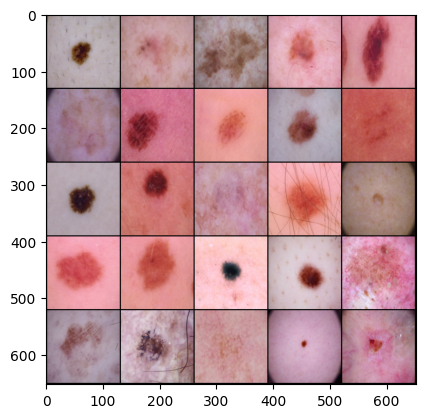

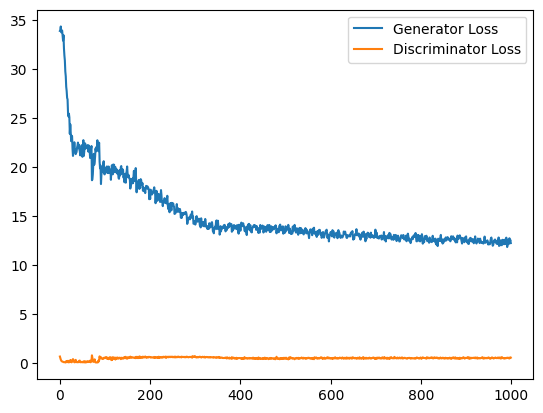

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
  7%|▋         | 19/282 [00:04<01:02,  4.23it/s]wandb: WARNING (User provided step: 70 is less than current step: 20002. Dropping entry: {'inception_score': 3.9267778396606445, '_timestamp': 1713062112.1002128}).
wandb: WARNING (User provided step: 70 is less than current st

Step 20400: Generator loss: 12.296060562133789, discriminator loss: 0.4693197011947632


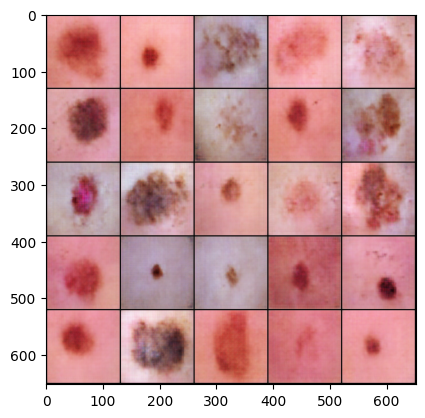

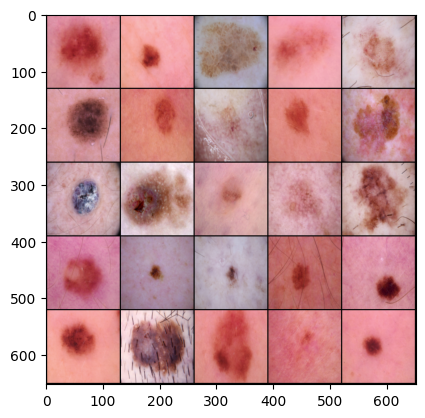

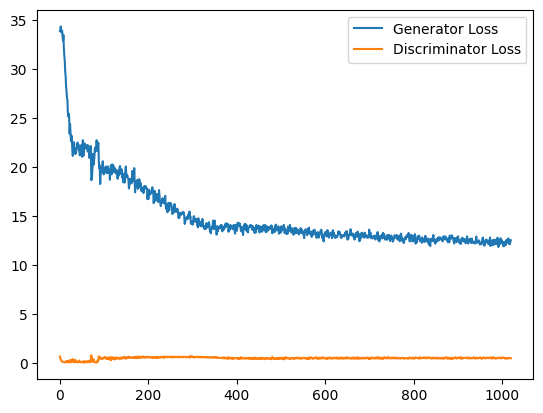

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
 76%|███████▌  | 213/282 [00:48<00:15,  4.38it/s]

Step 20800: Generator loss: 12.254998207092285, discriminator loss: 0.4705347716808319


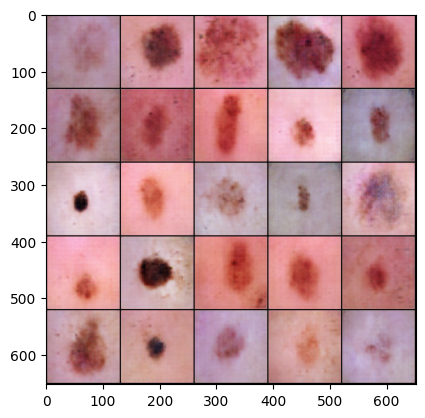

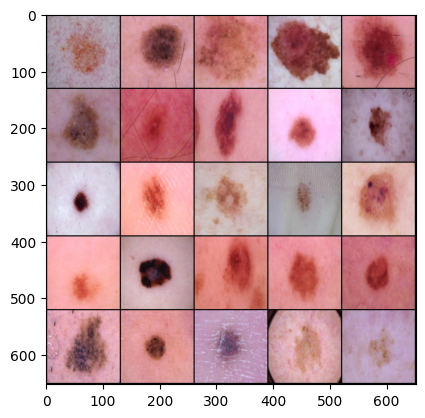

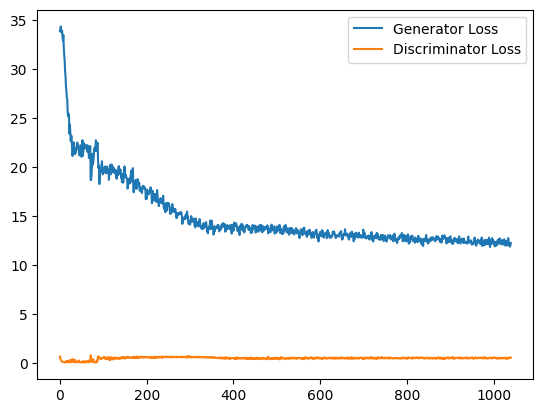

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value b

Step 21200: Generator loss: 12.156011581420898, discriminator loss: 0.48524340987205505


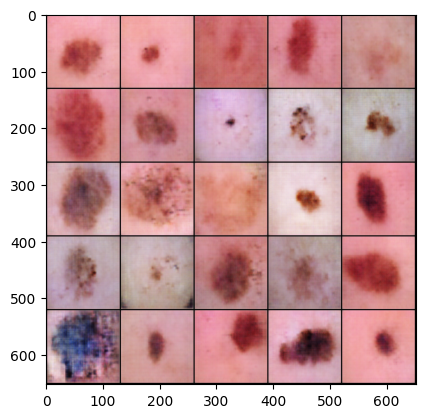

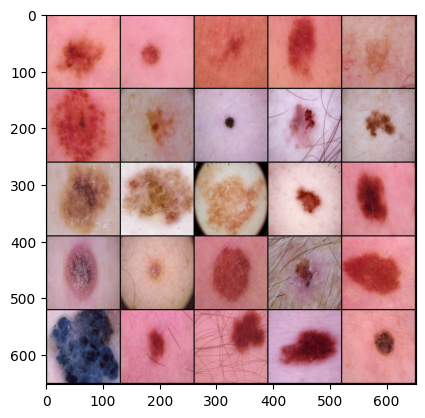

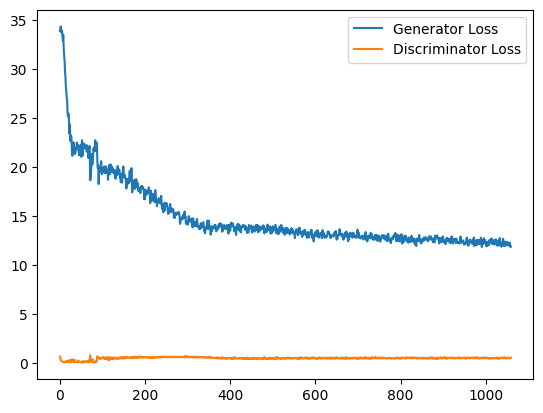

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
 59%|█████▉    | 167/282 [00:38<00:27,  4.14it/s]

Step 21600: Generator loss: 12.222208023071289, discriminator loss: 0.46906596422195435


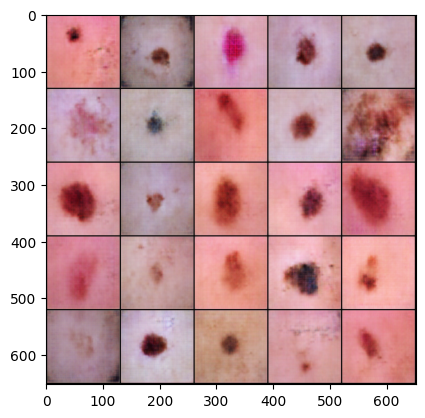

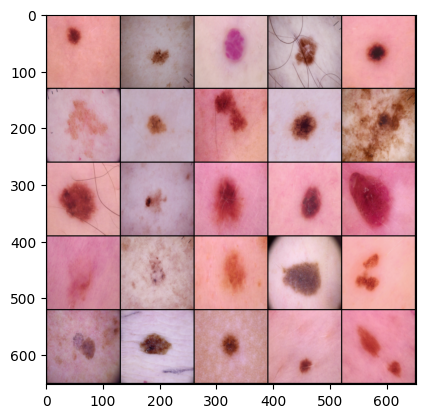

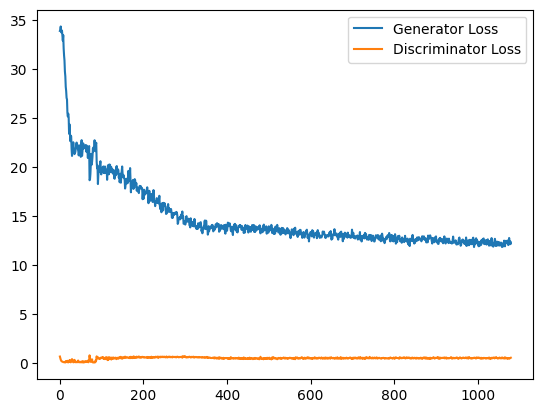

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value b

Step 22000: Generator loss: 12.214347839355469, discriminator loss: 0.4737517833709717


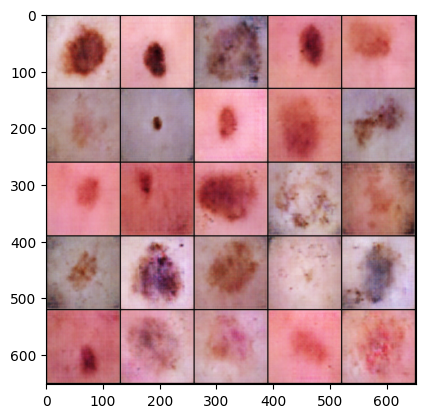

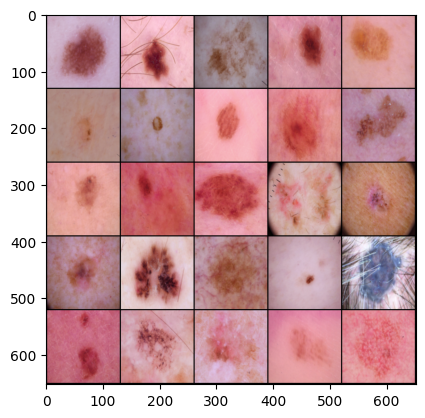

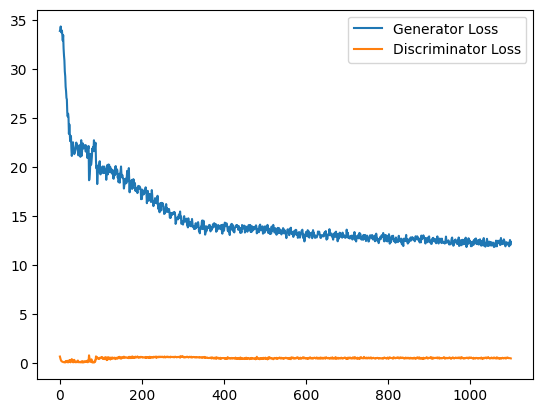

  4%|▍         | 12/282 [00:05<01:39,  2.71it/s]wandb: WARNING (User provided step: 77 is less than current step: 21602. Dropping entry: {'generator_loss_per_epoch': 13.019314765930176, 'discriminator_loss_per_epoch': 0.5406813025474548, '_timestamp': 1713062580.8999565}).
wandb: WARNING (User provided step: 78 is less than current step: 22002. Dropping entry: {'inception_score': 4.515087604522705, '_timestamp': 1713062585.032111}).
  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (c

Step 22400: Generator loss: 12.20189380645752, discriminator loss: 0.46858900785446167


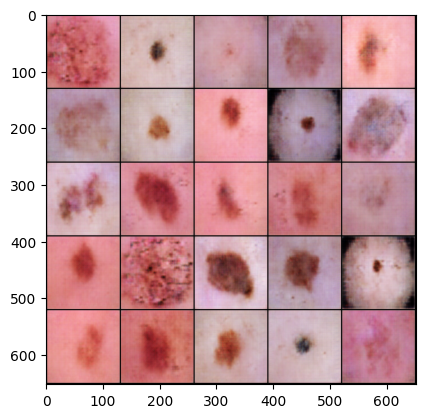

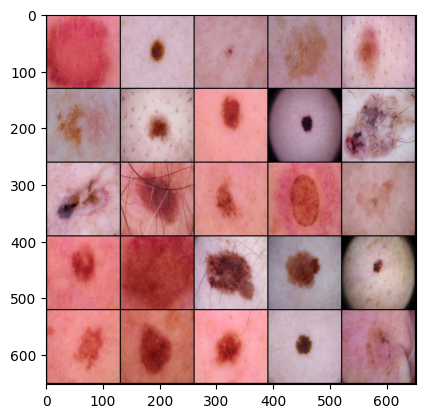

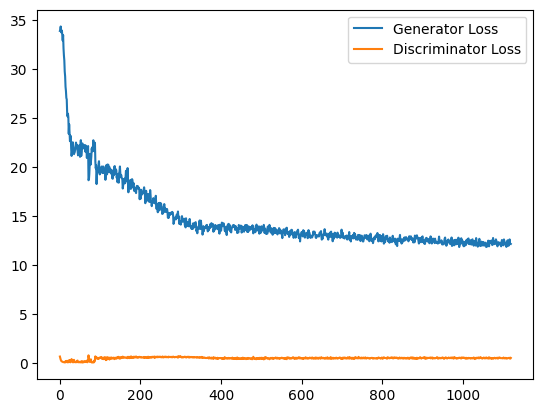

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
 85%|████████▍ | 239/282 [00:55<00:10,  4.05it/s]

Step 22800: Generator loss: 12.162471771240234, discriminator loss: 0.4680898189544678


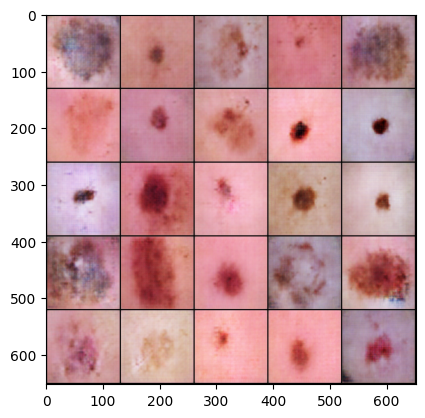

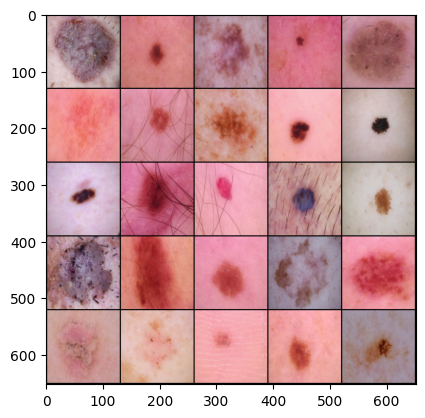

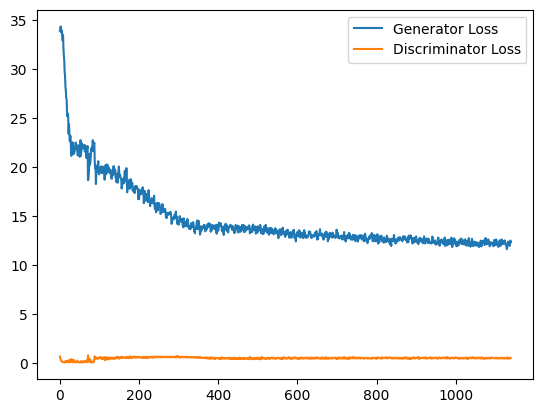

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value b

Step 23200: Generator loss: 12.186441421508789, discriminator loss: 0.4564802348613739


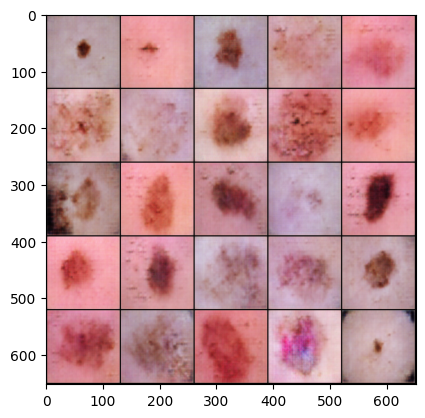

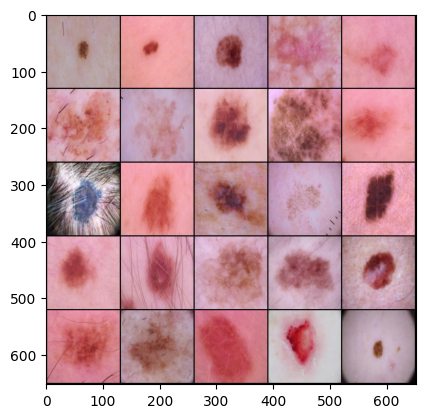

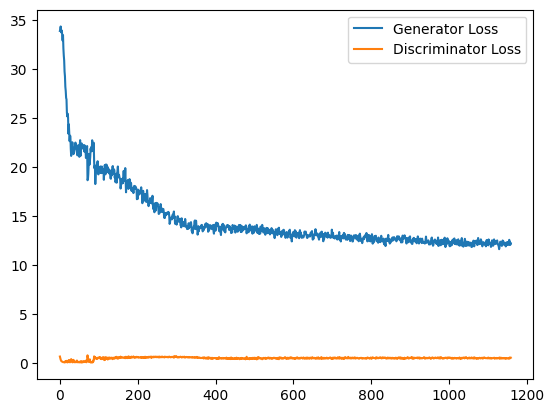

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
 68%|██████▊   | 193/282 [00:44<00:19,  4.46it/s]

Step 23600: Generator loss: 12.064590454101562, discriminator loss: 0.46833333373069763


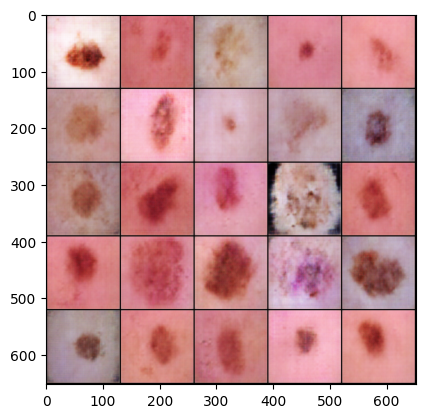

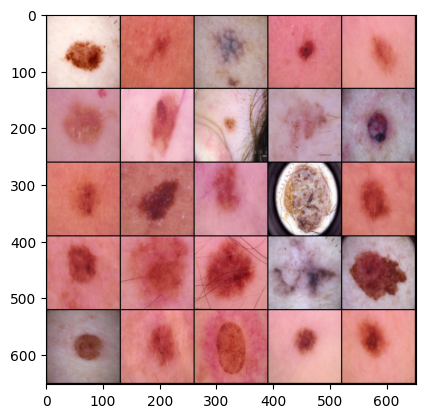

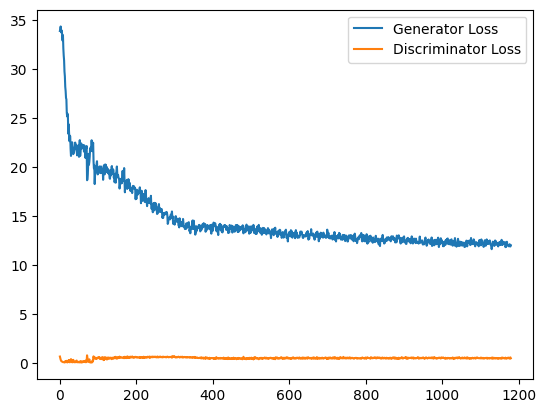

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value b

Step 24000: Generator loss: 12.094684600830078, discriminator loss: 0.4655269980430603


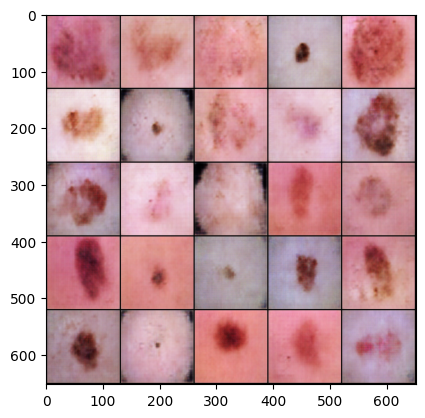

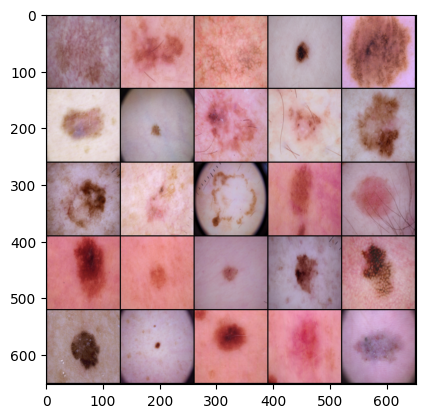

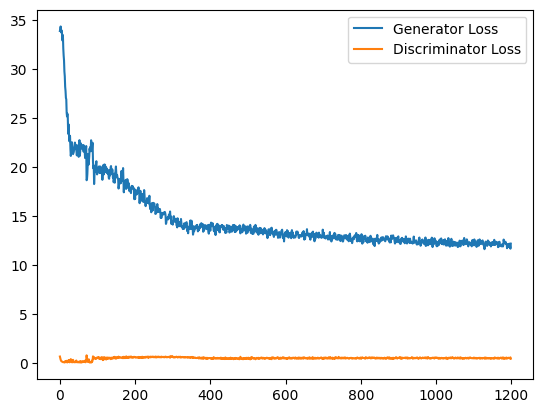

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
 52%|█████▏    | 148/282 [00:36<00:29,  4.57it/s]

Step 24400: Generator loss: 12.025673866271973, discriminator loss: 0.47072818875312805


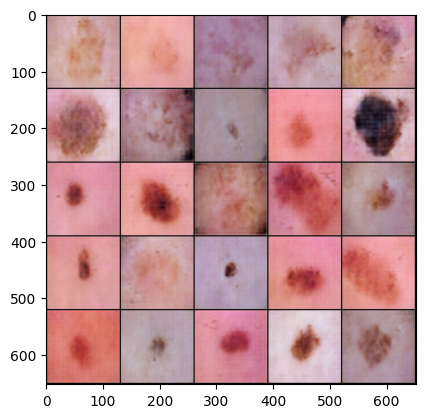

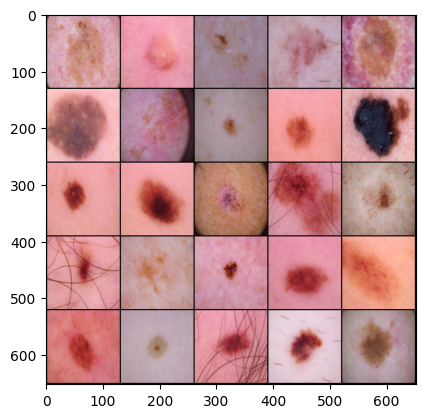

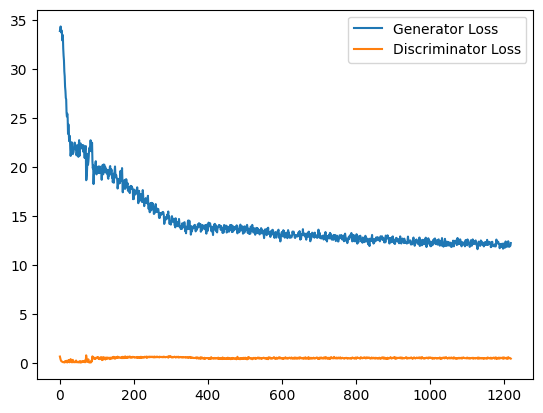

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
 94%|█████████▍| 265/282 [01:03<00:03,  4.55it/s]

Step 24800: Generator loss: 12.00024127960205, discriminator loss: 0.462494432926178


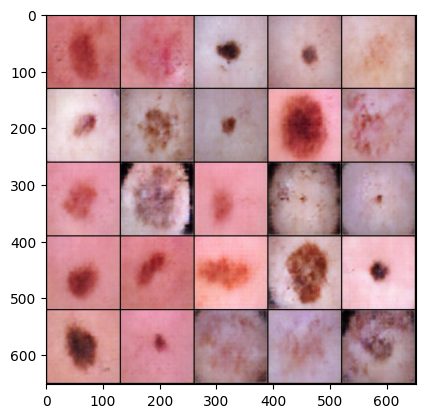

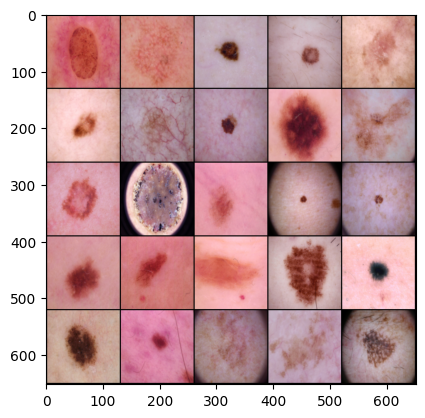

wandb: WARNING (User provided step: 87 is less than current step: 24802. Dropping entry: {'inception_score': 4.452444076538086, '_timestamp': 1713063261.3160262}).


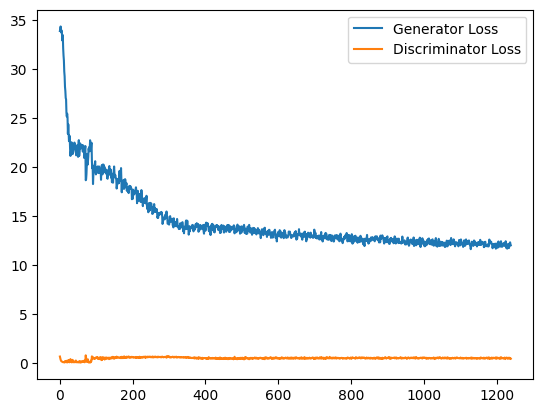

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value b

Step 25200: Generator loss: 11.991521835327148, discriminator loss: 0.46658259630203247


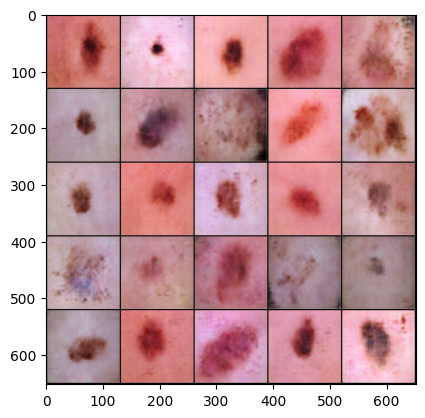

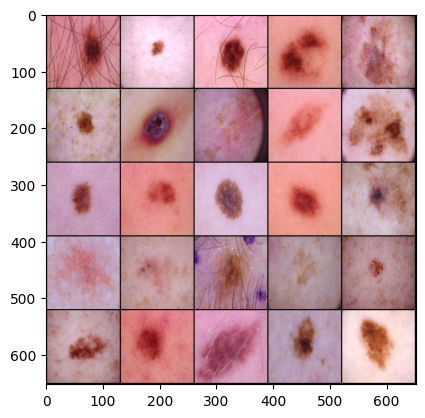

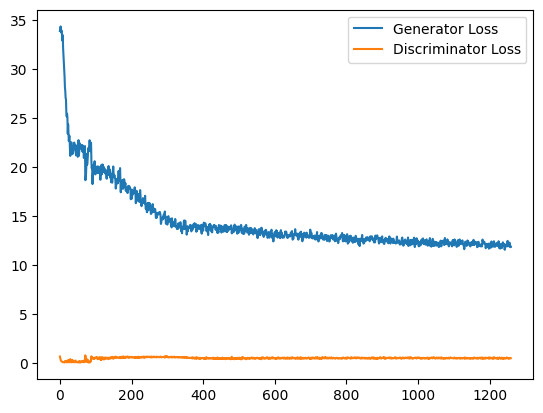

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
 78%|███████▊  | 219/282 [00:50<00:13,  4.51it/s]

Step 25600: Generator loss: 11.954381942749023, discriminator loss: 0.46103018522262573


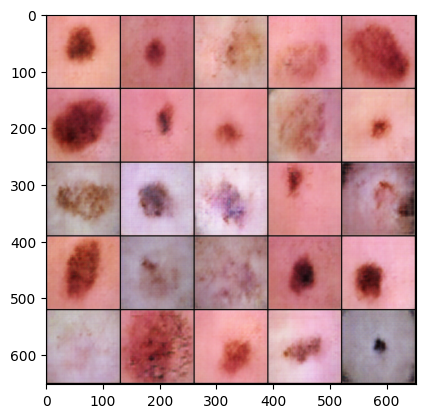

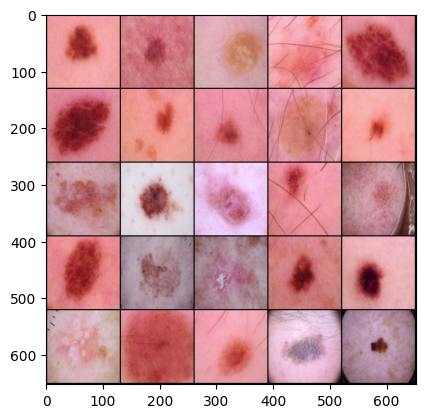

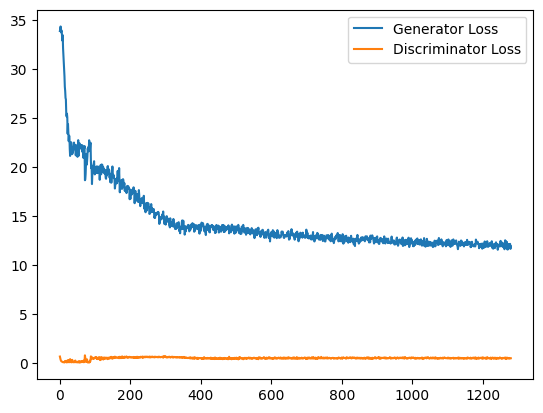

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value b

Step 26000: Generator loss: 12.02281379699707, discriminator loss: 0.4596661627292633


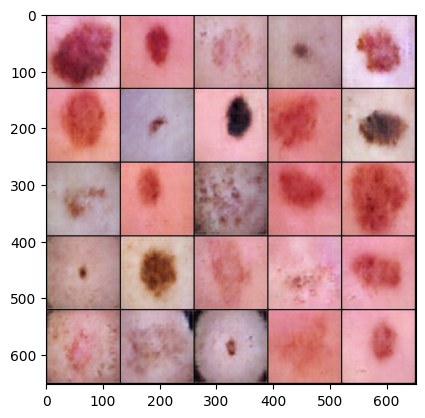

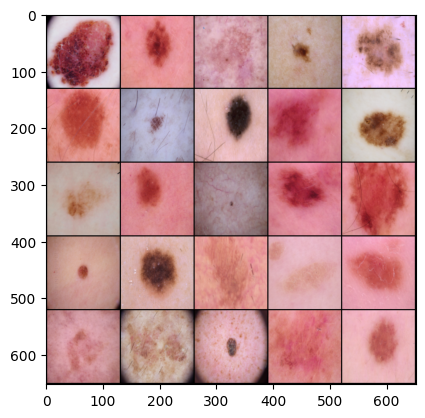

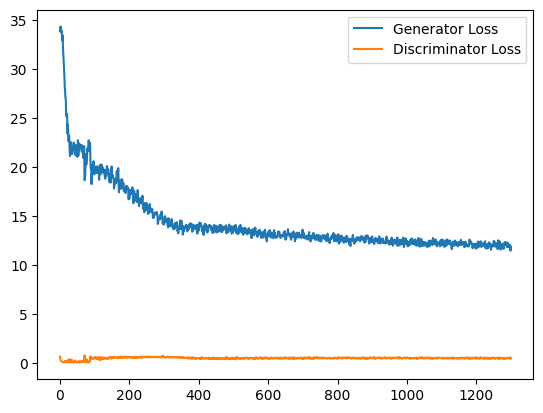

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
wandb: WARNING (User provided step: 92 is less than current step: 26002. Dropping entry: {'generator_loss_per_epoch': 12.971088409423828, 'discriminator_loss_per_epoch': 0.3925836682319641, '_timestamp': 1713063606.6653411}).
 61%|██████▏   | 173/282 [00:40<00:25,  4.21it/s]

Step 26400: Generator loss: 11.887761116027832, discriminator loss: 0.4782960116863251


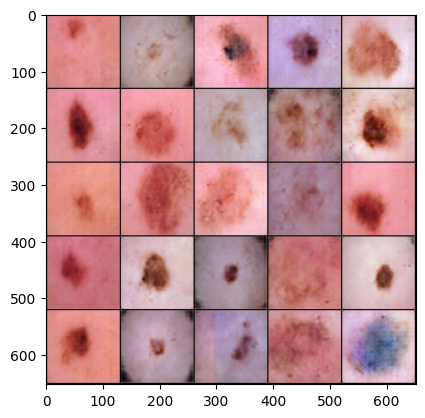

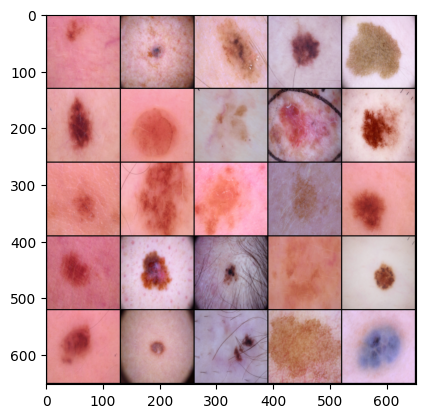

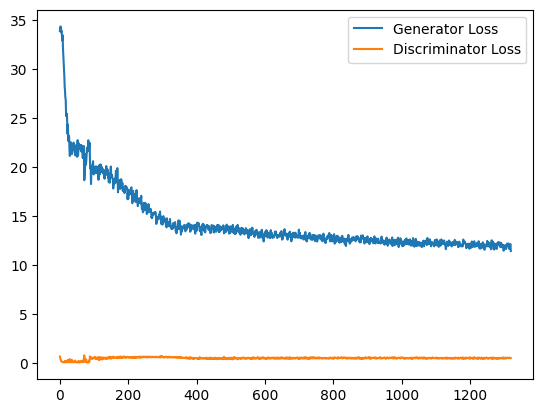

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value b

Step 26800: Generator loss: 12.00669002532959, discriminator loss: 0.4484284818172455


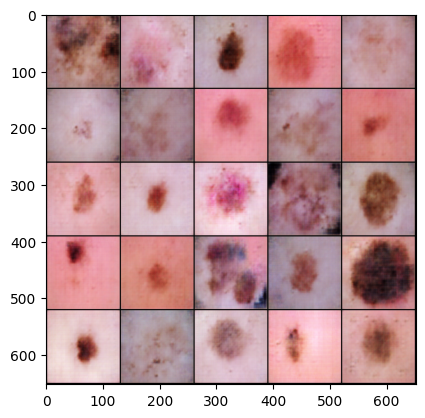

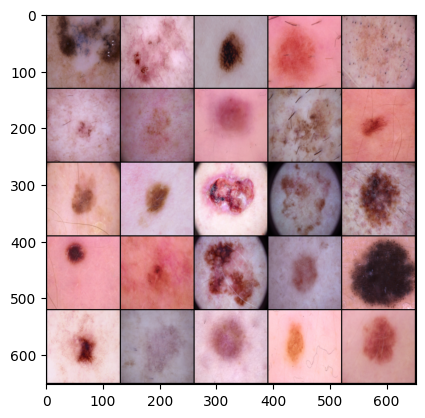

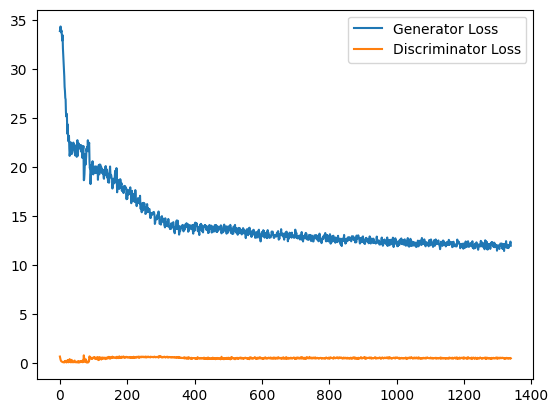

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
 45%|████▌     | 127/282 [00:29<00:34,  4.49it/s]

Step 27200: Generator loss: 11.843646049499512, discriminator loss: 0.4579303562641144


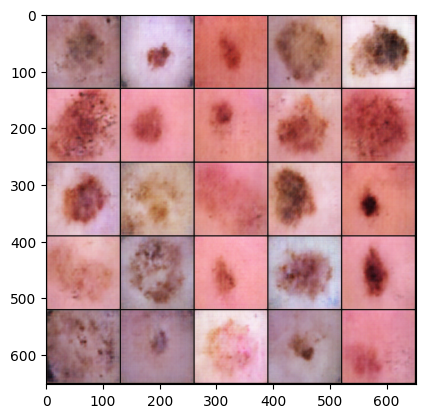

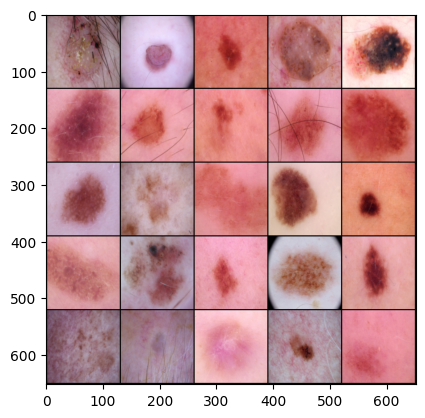

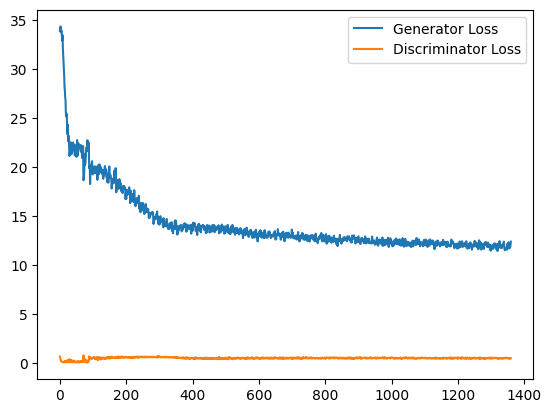

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
wandb: WARNING (User provided step: 96 is less than current step: 27202. Dropping entry: {'generator_loss_per_epoch': 13.48855209350586, 'discriminator_loss_per_epoch': 0.3855912983417511, '_timestamp': 1713063876.994867}).
 87%|████████▋ | 245/282 [00:56<00:08,  4.41it/s]

Step 27600: Generator loss: 11.834566116333008, discriminator loss: 0.4631372392177582


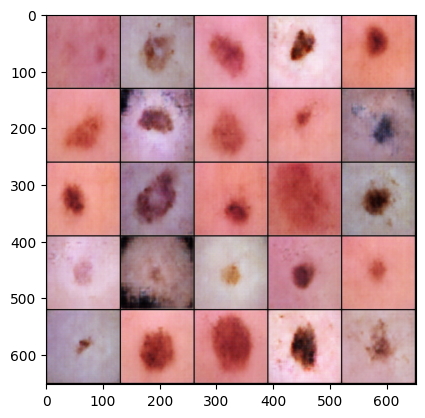

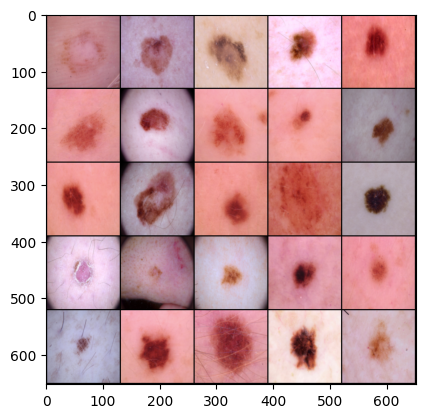

wandb: WARNING (User provided step: 97 is less than current step: 27602. Dropping entry: {'inception_score': 3.764636754989624, '_timestamp': 1713063936.5802875}).


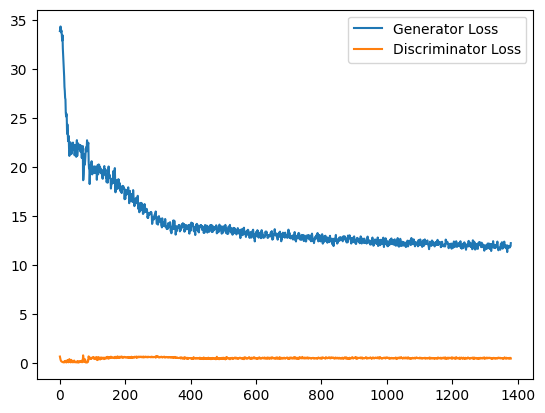

  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  label = torch.tensor(self.data_frame.iloc[idx, 1:], dtype=torch.float32)
  0%|          | 0/282 [00:00<?, ?it/s]/tmp/ipykernel_34/2379273028.py:16: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value b

Step 28000: Generator loss: 11.940014839172363, discriminator loss: 0.4563300907611847


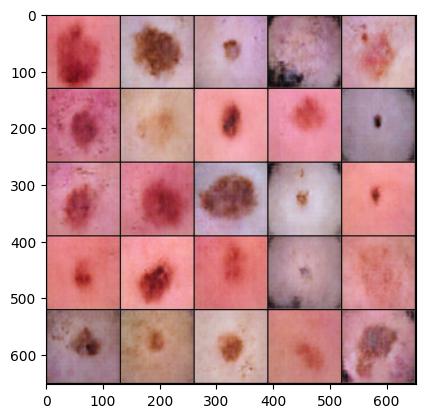

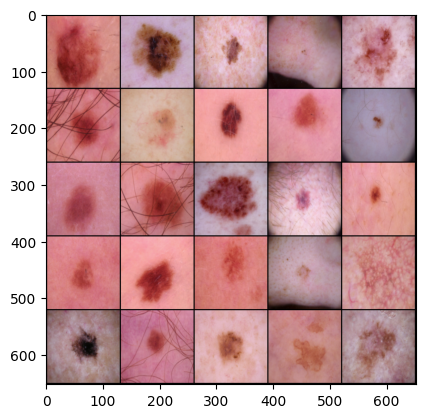

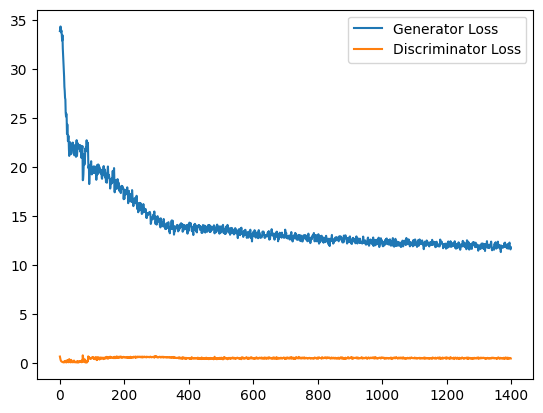

100%|██████████| 282/282 [01:07<00:00,  4.17it/s]


discriminator_loss_per_epoch,▁
discriminator_loss_per_step,▁▁▂▆▇▇▇███▇▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆▆
generator_loss_per_epoch,▁
generator_loss_per_step,█▅▄▄▄▃▃▂▂▂▂▂▂▂▂▂▂▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁▁
discriminator_loss_per_epoch,0.02426
discriminator_loss_per_step,0.45633
generator_loss_per_epoch,26.76892
generator_loss_per_step,11.94001


In [32]:
for epoch in range(n_epochs):
    epoch_generator_loss = 0.0
    epoch_discriminator_loss = 0.0
    num_batches = 0
    for real, labels, sketches, _ in tqdm(data_loader.train_dataloader()):
        cur_batch_size = len(real)
        real, labels, sketches = real.to(DEVICE), labels.to(DEVICE), sketches.to(DEVICE)
        
        fake = generator(sketches, labels.to(torch.long)).to(DEVICE)
        disc_real = discriminator(real, labels.to(torch.long)).reshape(-1).to(DEVICE)
        loss_disc_real = criterion(disc_real, torch.ones_like(disc_real))
        
        disc_fake = discriminator(fake.detach(), labels.to(torch.long)).reshape(-1)
        loss_disc_fake = criterion(disc_fake, torch.zeros_like(disc_fake))
        loss_disc = (loss_disc_real + loss_disc_fake) /  2
        discriminator.zero_grad()
        loss_disc.backward()
        discriminator_optimizer.step()
#         for _ in range(2):
# #             label_for_noise = labels.unsqueeze(-1).unsqueeze(-1).expand(-1, -1, 128, 128).to(DEVICE)
# #             noise_and_labels = torch.cat((sketches.float(), label_for_noise.float()), 1).to(DEVICE)
#             fake = generator(sketches, labels.to(torch.long)).to(DEVICE)

#     #         labels_unsqueezed = labels.unsqueeze(-1).unsqueeze(-1)
#     #         lables_with_image_dim = labels_unsqueezed.expand(-1, -1, 128, 128).to(DEVICE)
# #             fake_image_and_labels =  torch.cat((fake.float(), label_for_noise.float()), 1).to(DEVICE)
# #             real_image_and_labels = torch.cat((real.float(), label_for_noise.float()), 1).to(DEVICE)

#             disc_real_pred = discriminator(real, labels.to(torch.long)).to(DEVICE)
#             disc_fake_pred = discriminator(fake, labels.to(torch.long)).to(DEVICE)

#             alpha = torch.rand((real.shape[0], 1, 1, 1)).repeat(1, real.shape[1], real.shape[2], real.shape[3]).to(DEVICE)
#             interpolated_images = real * alpha + fake * (1 - alpha)
#             mixed_scores = discriminator(interpolated_images, labels.to(torch.long))

#             gradient = torch.autograd.grad(
#                 inputs = interpolated_images,
#                 outputs = mixed_scores,
#                 grad_outputs = torch.ones_like(mixed_scores),
#                 create_graph = True,
#                 retain_graph = True,
#             )[0]
#             gradient = gradient.view(gradient.shape[0], -1)
#             gradient_norm = gradient.norm(2, dim=1)
#             gradient_penalty = torch.mean((gradient_norm - 1) ** 2)

#             loss_critic = (
#                 -(torch.mean(disc_real_pred) - torch.mean(disc_fake_pred)) + 10 * gradient_penalty
#             )
#             discriminator.zero_grad()
#             loss_critic.backward(retain_graph=True)
#             discriminator_optimizer.step()
            
        gen_fake = discriminator(fake, labels.to(torch.long)).reshape(-1)
        loss_gen1 = criterion(gen_fake, torch.ones_like(gen_fake))
        l1_loss = L1_LOSS(fake, real) * 100
        loss_gen = loss_gen1 + l1_loss
        generator.zero_grad()
        loss_gen.backward()
        generator_optimizer.step()
        
#         disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
#         disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
#         disc_loss = (disc_fake_loss + disc_real_loss) / 2
#         disc_loss.backward(retain_graph=True)
#         discriminator_optimizer.step()
        discriminator_losses += [loss_disc]

#         generator_optimizer.zero_grad()

#         fake_image_and_labels = torch.cat((fake.float(), lables_with_image_dim.float()), 1)
#         disc_fake_pred = discriminator(fake_image_and_labels)


#         gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))

#         gen_loss.backward()
#         generator_optimizer.step()

        generator_losses += [loss_gen]
#         wandb.log({"generator_loss_per_step": loss_gen, "discriminator_loss_per_step": loss_disc}, step=cur_step)
        epoch_generator_loss += loss_gen.item()
        epoch_discriminator_loss += loss_disc.item()
        num_batches += 1
        if cur_step % display_step == 0 and cur_step > 0:

            gen_mean = sum(generator_losses[-display_step:]) / display_step

            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(
                f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}"
            )
            wandb.log({"generator_loss_per_step": gen_mean, "discriminator_loss_per_step": disc_mean}, step=cur_step)

            plot_images_from_tensor(fake, name="fake_images")
            plot_images_from_tensor(real, name="real_images")
            
#             fake_images = generator(sketches, labels.to(torch.long)).detach()
            is_score = inception_score(fake.to("cpu"))
            fid_score = calculate_fid(real, fake, device='cpu')
            wandb.log({"inception_score": is_score, "FID score": fid_score}, step=cur_step)

            step_bins = 20
            x_axis = sorted(
                [i * step_bins for i in range(len(generator_losses) // step_bins)]
                * step_bins
            )
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins),
                torch.Tensor(generator_losses[:num_examples])
                .view(-1, step_bins)
                .mean(1),
                label="Generator Loss",
            )
            plt.plot(
                range(num_examples // step_bins),
                torch.Tensor(discriminator_losses[:num_examples])
                .view(-1, step_bins)
                .mean(1),
                label="Discriminator Loss",
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Let Long Training Continue")
        cur_step += 1
    avg_epoch_generator_loss = epoch_generator_loss / num_batches
    avg_epoch_discriminator_loss = epoch_discriminator_loss / num_batches
    wandb.log({"generator_loss_per_epoch": avg_epoch_generator_loss, "discriminator_loss_per_epoch": avg_epoch_discriminator_loss}, step=epoch)
wandb.finish()

In [33]:
torch.save(generator.state_dict(), 'generator.pth')

In [ ]:
classifier_model = torch.load('/kaggle/input/cnn_classifier/pytorch/model/1/cnn_classifier.pth')

In [ ]:
columns = ["classes", "images", "truth", "predictions"]
test_dt = wandb.Table(columns = columns)

In [ ]:
def evaluation(fake_images, class_labels):
  classifier_model.eval()
  total, correct = 0, 0

  with torch.no_grad():
      fake_images, class_labels = fake_images.to(DEVICE), class_labels.to(DEVICE)
      outputs = classifier_model(fake_images)
      probabilities = torch.nn.functional.softmax(outputs, dim=1)
      _, prediction = torch.max(probabilities, 1)
#       _, prediction = torch.max(outputs.data, 1)
      total = total + class_labels.size(0)
      correct = correct + (prediction == class_labels).sum().item()
  return correct * 100 / total, probabilities

In [ ]:
for key, value in dataloader_dict.items():
    for data in value:
        real, labels, sketches, classes = data
        fake = generator(sketches, labels)
        accuracy, probabilities = evaluation(fake, classes)
        
        real_images = [wandb.Image(image) for image in real]
        class_labels = classes.tolist()
        prediction_probabilities = probabilities.tolist()
        
        rows = zip(class_labels, real_images, class_labels, prediction_probabilities)
        for row in rows:
            test_dt.add_data(*row)

In [ ]:
wandb.log({TEST_TABLE_NAME : test_dt})